# Getting to the final manifold of all MFI data (cells and nuclei)

11.2021

here rerunning the full analysis after (1) excluding the inter-individual doublets and (2) excluding scrublet called doublets; (3) doing coarse and per-compartment zoom in analysis and annotation

after doing scVI with soupy gene filtering

In [1]:
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import seaborn as sns
import scanpy as sc
import anndata
import bbknn
# requires 'pip install scrublet'
#import scrublet as scr
import os
import matplotlib as mpl
import scipy
import matplotlib.pyplot as plt
import pickle

In [2]:
np.random.seed(0)

In [3]:
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_versions()
sc.settings.set_figure_params(dpi=80)  # low dpi (dots per inch) yields small inline figures

-----
anndata     0.7.5
scanpy      1.7.1
sinfo       0.3.1
-----
PIL                 8.1.2
anndata             0.7.5
annoy               NA
anyio               NA
attr                20.3.0
babel               2.9.0
backcall            0.2.0
bbknn               NA
brotli              NA
cairo               1.20.0
certifi             2021.10.08
cffi                1.14.5
chardet             4.0.0
cloudpickle         1.6.0
colorama            0.4.4
cycler              0.10.0
cython_runtime      NA
cytoolz             0.11.0
dask                2021.03.1
dateutil            2.8.1
decorator           4.4.2
fsspec              0.8.7
get_version         2.1
google              NA
h5py                3.1.0
idna                2.10
igraph              0.8.3
ipykernel           5.5.0
ipython_genutils    0.2.0
ipywidgets          7.6.3
jedi                0.18.0
jinja2              2.11.3
joblib              1.0.1
json5               NA
jsonschema          3.2.0
jupyter_server      1.4.1
jupyte

In [4]:
save_path = '/lustre/scratch117/cellgen/team292/aa22/adata_objects/202111_MFI_sc_sn_new_scVI_analysis/'

## Reading the preprocessed object

Preprocessing happened S0 notebook

In [5]:
# reading
adata = sc.read(save_path+'adata_raw_filtered.h5ad')

KeyboardInterrupt: 

In [6]:
# trophoblast annotations
annot_troph = pd.read_csv(save_path + 'obs_table_all_troph_v3_prelim_annot.csv', index_col=0)
np.unique(annot_troph['annot_troph'])

/opt/conda/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3165: DtypeWarning: Columns (6,32) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


array(['EVT_1', 'EVT_2', 'GC', 'SCT', 'VCT', 'VCT_CCC', 'VCT_fusing',
       'VCT_p', 'eEVT', 'iEVT', 'rest'], dtype=object)

In [7]:
annot_troph['annot_troph'].value_counts()

SCT           28177
VCT           23472
VCT_p          6679
EVT_1          5289
iEVT           3676
VCT_CCC        3373
EVT_2          2358
VCT_fusing     1971
rest            813
eEVT             28
GC               19
Name: annot_troph, dtype: int64

In [8]:
# dS + uSMC annotations
annot_dS_uSMC = pd.read_csv(save_path + 'annot_dS_uSMC.csv', index_col=0)
np.unique(annot_dS_uSMC['annot_dS_uSMC'])

array(['PV', 'dS1', 'dS2', 'dS3', 'mix', 'uSMC'], dtype=object)

In [9]:
# NK annotations
annot_NK = pd.read_csv(save_path + 'annot_NK.csv', index_col=0)
np.unique(annot_NK['annot_NK'])

array(['ILC3', 'dNK1', 'dNK2', 'dNK3', 'mix'], dtype=object)

In [10]:
# T cell annotations
annot_T = pd.read_csv(save_path + 'annot_T.csv', index_col=0)
np.unique(annot_T['annot_T'])

array(['ILC3', 'NK', 'T_cells', 'dT_cells', 'dT_regs'], dtype=object)

In [11]:
# Myeloid annotations
annot_Myeloid = pd.read_csv(save_path + 'annot_Myeloid.csv', index_col=0)
np.unique(annot_Myeloid['annot_Myeloid'])

array(['B_cells', 'DC', 'Granulocytes', 'HOFB', 'M3', 'MO', 'Plasma',
       'dDC', 'dM1', 'dM2', 'mix'], dtype=object)

In [12]:
# Endothelial annotations
annot_Endothelial = pd.read_csv(save_path + 'annot_Endothelial.csv', index_col=0)
np.unique(annot_Endothelial['annot_Endothelial'])

array(['Endo_F', 'Endo_L', 'Endo_M', 'mix'], dtype=object)

In [13]:
# PV annotations
annot_PV = pd.read_csv(save_path + 'annot_PV.csv', index_col=0)
np.unique(annot_PV['annot_PV'])

array(['PV', 'mix'], dtype=object)

In [14]:
# Epithelial annotations
annot_Epithelial = pd.read_csv(save_path + 'annot_Epithelial.csv', index_col=0)
np.unique(annot_Epithelial['annot_Epithelial'])

array(['dEpi_lumenal', 'dEpi_secretory', 'mix'], dtype=object)

In [15]:
# fF annotations
annot_fF = pd.read_csv(save_path + 'annot_fF.csv', index_col=0)
np.unique(annot_fF['annot_fF'])

array(['fF1', 'fF2', 'mix'], dtype=object)

In [16]:
# reading IDs of final cells to keep after doublet exclusion (scrublet and souporcell)
nodoublet_IDs = pd.read_csv(save_path + 'selected_droplets_no_doublets_in_M1_prelim_analysis.csv', index_col=0)
nodoublet_IDs

/opt/conda/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3165: DtypeWarning: Columns (6) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


,n_genes,sample,technology,tissue,dev_age,donor,dataset,run,number_of_individuals_multiplexed,batch,...,probabilities,barcode_sample_copy,souporcell_assignment,inter_ind_doublet,S_score,G2M_score,phase,origin_M_F,is_doublet_0.05,is_doublet_0.01
barcode_sample,,,,,,,,,,,,,,,,,,,,,
AAACGGGCATTGGCGC-1_FCA7167219,1941,FCA7167219,10X_3'_scRNA-seq,decidua_immune,13_PCW,6,Vento_Nature,NaN,1,0,...,1.000000,AAACGGGCATTGGCGC-1_FCA7167219,FCA7167219_0,0,-0.022318,-0.029351,G1,M,0,0
AAACGGGTCGCGATCG-1_FCA7167219,1246,FCA7167219,10X_3'_scRNA-seq,decidua_immune,13_PCW,6,Vento_Nature,NaN,1,0,...,1.000000,AAACGGGTCGCGATCG-1_FCA7167219,FCA7167219_0,0,0.109294,-0.048533,S,M,0,0
AAAGATGAGCAATATG-1_FCA7167219,1516,FCA7167219,10X_3'_scRNA-seq,decidua_immune,13_PCW,6,Vento_Nature,NaN,1,0,...,0.999998,AAAGATGAGCAATATG-1_FCA7167219,FCA7167219_0,0,-0.045822,-0.097222,G1,M,0,0
AAAGATGAGTTCGCGC-1_FCA7167219,2099,FCA7167219,10X_3'_scRNA-seq,decidua_immune,13_PCW,6,Vento_Nature,NaN,1,0,...,1.000000,AAAGATGAGTTCGCGC-1_FCA7167219,FCA7167219_0,0,-0.033310,-0.112754,G1,M,0,0
AAAGATGCATGTCGAT-1_FCA7167219,1636,FCA7167219,10X_3'_scRNA-seq,decidua_immune,13_PCW,6,Vento_Nature,NaN,1,0,...,1.000000,AAAGATGCATGTCGAT-1_FCA7167219,FCA7167219_0,0,0.033493,-0.107313,S,M,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTGTTCGTCAAGT-1_Pla_Camb10714920,2409,Pla_Camb10714920,10X_multiome,decidua_placenta_myometrium,8-9_PCW,P13,Ashley_collection_sn,NaN,1,61,...,0.957605,TTTGTGTTCGTCAAGT-1_Pla_Camb10714920,Pla_Camb10714920_0,0,0.008248,-0.176324,S,M,0,0
TTTGTGTTCTTAGTCT-1_Pla_Camb10714920,4129,Pla_Camb10714920,10X_multiome,decidua_placenta_myometrium,8-9_PCW,P13,Ashley_collection_sn,NaN,1,61,...,1.000000,TTTGTGTTCTTAGTCT-1_Pla_Camb10714920,Pla_Camb10714920_1,0,-0.073279,-0.153125,G1,F,0,0
TTTGTTGGTCACAGCG-1_Pla_Camb10714920,3116,Pla_Camb10714920,10X_multiome,decidua_placenta_myometrium,8-9_PCW,P13,Ashley_collection_sn,NaN,1,61,...,0.989358,TTTGTTGGTCACAGCG-1_Pla_Camb10714920,Pla_Camb10714920_1,0,-0.010057,-0.110007,G1,F,0,0


In [17]:
# subsetting the adata object to final cells
adata = adata[list(nodoublet_IDs.index), :].copy()
adata

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


AnnData object with n_obs × n_vars = 378558 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature_types-16', 'genome-16', 'n_cells-16', 'gene_ids-17', 'feature_types-17', 'genome-17', 'n_cells-17', 'gene_ids-18', 'feature_types-18', 'genome-18', 'n_cells-18', 'gene_ids-19', 'feature_types-1

In [18]:
# adding metadata
for col in nodoublet_IDs.columns:
    print(col)
    adata.obs[col] = nodoublet_IDs.loc[adata.obs_names,col]

n_genes
sample
technology
tissue
dev_age
donor
dataset
run
number_of_individuals_multiplexed
batch
percent_mito
n_counts
scrublet_score
scrublet_cluster_score
bh_pval
is_doublet
celltype_predictions
probabilities
barcode_sample_copy
souporcell_assignment
inter_ind_doublet
S_score
G2M_score
phase
origin_M_F
is_doublet_0.05
is_doublet_0.01


In [19]:
# add labels of coarse annotation
coarse_annot = pd.read_csv(save_path + 'obs_table_with_coarse_annot_from_M4_notebook_all_cell_states.csv', index_col=0)
adata.obs['coarse_annot'] = coarse_annot.loc[adata.obs_names,'annot_coarse']

/opt/conda/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3165: DtypeWarning: Columns (6,28) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [20]:
adata.obs['coarse_annot'].value_counts()

dS_uSMC        158106
Trophoblast     81704
Myeloid         43997
NK              30132
T               19244
Epithelial      18222
Endothelial     12689
fF              12633
PV               1831
Name: coarse_annot, dtype: int64

In [21]:
def annot_cell_types(adata_obj, barcode_sample):
    
    #print(barcode_sample)
    curr_coarse_annot = adata_obj.obs.loc[barcode_sample,'coarse_annot']
    #print(curr_coarse_annot)
    
    if curr_coarse_annot == 'dS_uSMC':
        return(annot_dS_uSMC.loc[barcode_sample,'annot_dS_uSMC'])
    elif curr_coarse_annot == 'Trophoblast':
        if barcode_sample in annot_troph.index:
            return(annot_troph.loc[barcode_sample,'annot_troph'])
        else:
            return('dropped_trophoblast')
    elif curr_coarse_annot == 'Myeloid':
        return(annot_Myeloid.loc[barcode_sample,'annot_Myeloid'])
    elif curr_coarse_annot == 'NK':
        return(annot_NK.loc[barcode_sample,'annot_NK'])
    elif curr_coarse_annot == 'T':
        return(annot_T.loc[barcode_sample,'annot_T'])
    elif curr_coarse_annot == 'Epithelial':
        return(annot_Epithelial.loc[barcode_sample,'annot_Epithelial'])
    elif curr_coarse_annot == 'Endothelial':
        return(annot_Endothelial.loc[barcode_sample,'annot_Endothelial'])
    elif curr_coarse_annot == 'fF':
        return(annot_fF.loc[barcode_sample,'annot_fF'])
    elif curr_coarse_annot == 'PV':
        return(annot_PV.loc[barcode_sample,'annot_PV']) 
    else:
        print(barcode)
        return('None')

In [22]:
adata.obs['cell_type'] = adata.obs['barcode_sample_copy'].apply(lambda x: annot_cell_types(adata,x))

In [23]:
# need to get rid of 'mix', 'dropped_trophoblast' and 'rest'
# updated on 23.11.2021
adata.obs['cell_type'].value_counts()

dS2                    65746
dS1                    42586
SCT                    28177
VCT                    23472
mix                    21081
uSMC                   17043
dEpi_secretory         16834
dM1                    14099
dS3                    13197
dNK2                   12487
HOFB                   10733
dNK1                   10450
fF1                    10420
PV                      9980
dT_cells                9740
dM2                     9221
Endo_M                  6877
VCT_p                   6679
dropped_trophoblast     5849
EVT_1                   5289
NK                      5187
iEVT                    3676
VCT_CCC                 3373
MO                      3050
dNK3                    2952
ILC3                    2511
EVT_2                   2358
T_cells                 2126
VCT_fusing              1971
dT_regs                 1862
Endo_L                  1761
Endo_F                  1466
fF2                     1396
M3                      1299
rest          

In [24]:
adata = adata[-adata.obs['cell_type'].isin(['mix', 'dropped_trophoblast','rest'])].copy()

In [25]:
# checking that the values are raw 
np.unique(adata.obs['sample'])

array(['FCA7167219', 'FCA7167221', 'FCA7167222', 'FCA7167223',
       'FCA7167224', 'FCA7167226', 'FCA7167230', 'FCA7167231',
       'FCA7167232', 'FCA7196218', 'FCA7196219', 'FCA7196220',
       'FCA7196224', 'FCA7196225', 'FCA7196226', 'FCA7196229',
       'FCA7196231', 'FCA7474062', 'FCA7474063', 'FCA7474064',
       'FCA7474065', 'FCA7474066', 'FCA7474068', 'FCA7474069',
       'FCA7511881', 'FCA7511882', 'FCA7511883', 'FCA7511884',
       'FCA7511885', 'FCA7511886', 'Pla_Camb10691970', 'Pla_Camb10691971',
       'Pla_Camb10691972', 'Pla_Camb10691975', 'Pla_Camb10714918',
       'Pla_Camb10714919', 'Pla_Camb10714920', 'Pla_HDBR10142767',
       'Pla_HDBR10142768', 'Pla_HDBR10142769', 'Pla_HDBR10142770',
       'Pla_HDBR10142863', 'Pla_HDBR10142864', 'Pla_HDBR10142865',
       'Pla_HDBR10701666', 'Pla_HDBR10701667', 'Pla_HDBR10701668',
       'Pla_HDBR10917730', 'Pla_HDBR10917731', 'Pla_HDBR10917733',
       'Pla_HDBR8624430', 'Pla_HDBR8624431', 'Pla_HDBR8715512',
       'Pla_HDBR87

In [26]:
expr_mtx = adata[adata.obs['sample'] == 'WSSS_PLA8764121'].X.todense()
np.unique(expr_mtx)

matrix([[   0.,    0.,    0., ..., 1902., 2222., 2347.]], dtype=float32)

In [28]:
len(adata)

350815

In [30]:
# saving final annotation
#pd.DataFrame(adata.obs['cell_type']).to_csv(save_path + 'final_annotation_all_cells_and_nulcei_20211115.csv')

# after M3 annotation
#pd.DataFrame(adata.obs['cell_type']).to_csv(save_path + 'final_annotation_all_cells_and_nulcei_20211117.csv')

# after final correction of annotation (dS, T cells and fF)
#pd.DataFrame(adata.obs['cell_type']).to_csv(save_path + 'final_annotation_all_cells_and_nulcei_20211119.csv')

# after updating & correcting annotation (inv troph, mostly GC and eEVT)
pd.DataFrame(adata.obs['cell_type']).to_csv(save_path + 'final_annotation_all_cells_and_nulcei_20211123.csv')

___________

# Preparation for scVI: 

1) Calculating cell cycle-associated genes (to later be excluded in scVI analysis)
2) Calculating a minimum extimate of number of latent variables to use in scVI analysis later (when doing batch correction) as the number of PCs optimally explaining this data

Let's see if cell cycle has an effect in trophoblast and remember them to exclude in scVI calculation

In [27]:
adata_copy = adata.copy()

In [28]:
# normalise and log transform
sc.pp.normalize_per_cell(adata_copy, counts_per_cell_after=1e4)
sc.pp.log1p(adata_copy)

# saving normalised and log transformed values into the raw attribute to later be able to plot
adata_copy.raw = adata_copy.copy()

adata_copy.var_names_make_unique()
adata_copy.obs_names_make_unique()

normalizing by total count per cell
    finished (0:00:16): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


In [29]:
# excluding soupy genes as per notebook M3a-1

# gene stats for cells
gene_stats_sc = pd.read_csv(save_path + 'gene_filter_cells_upd_20211111.csv', index_col=0)

# gene stats for nuclei
gene_stats_sn = pd.read_csv(save_path + 'gene_filter_nuclei_upd_20211111.csv', index_col=0)

genes2keep_sc = list(gene_stats_sc[gene_stats_sc['Selected'] == True].index)
genes2keep_sn = list(gene_stats_sn[gene_stats_sn['Selected'] == True].index)

# overlap
genes2keep = list(set(genes2keep_sc) & set(genes2keep_sn))

len(genes2keep)

7849

In [30]:
adata_copy = adata_copy[:,list(set(genes2keep) & set(adata_copy.var_names))].copy()
adata_copy

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


AnnData object with n_obs × n_vars = 350815 × 7848
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01', 'coarse_annot', 'cell_type'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells

_____________________________________________________________________________________________________________________________________________________________

### Filter Cell cycle genes 
Per genes analysis: identify genes behaving like known cell cycle genes

extracting highly variable genes
    finished (0:00:02)


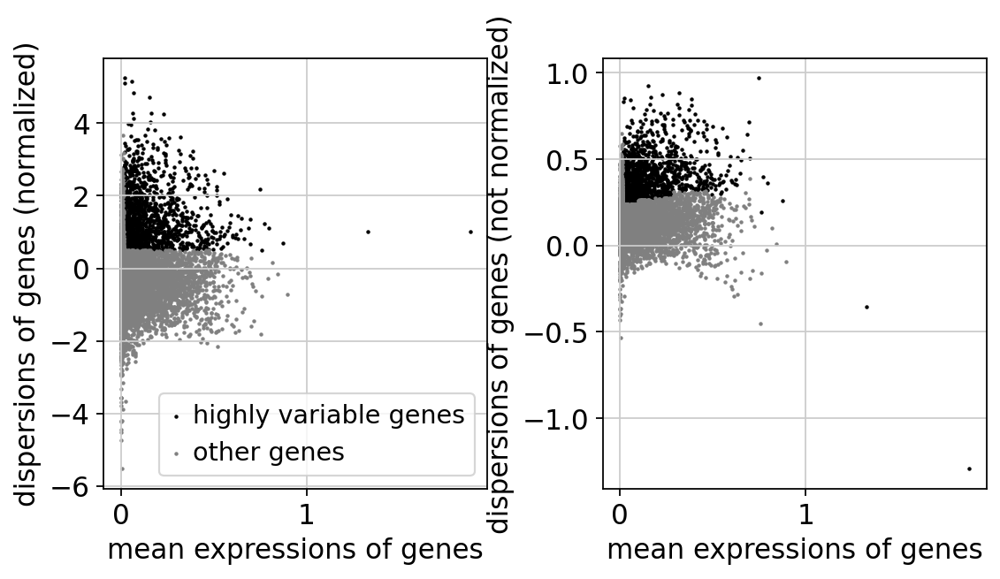

In [33]:
cellcycle_adata = adata_copy.copy()
# Extract highly variable genes
filter_result = sc.pp.filter_genes_dispersion(
    cellcycle_adata.X, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.filter_genes_dispersion(filter_result,save='_ccg_identification.pdf')

In [34]:
# Traspose matrix for a GENE-centered analysis
cellcycle_adata = cellcycle_adata.T
cellcycle_adata = cellcycle_adata[filter_result.gene_subset,:]


/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [35]:
# Scale data to unit variance and zero mean
sc.pp.scale(cellcycle_adata, max_value=10)
# PCA
sc.tl.pca(cellcycle_adata, svd_solver='arpack')

/opt/conda/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:810: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    with n_comps=50
    finished (0:00:39)


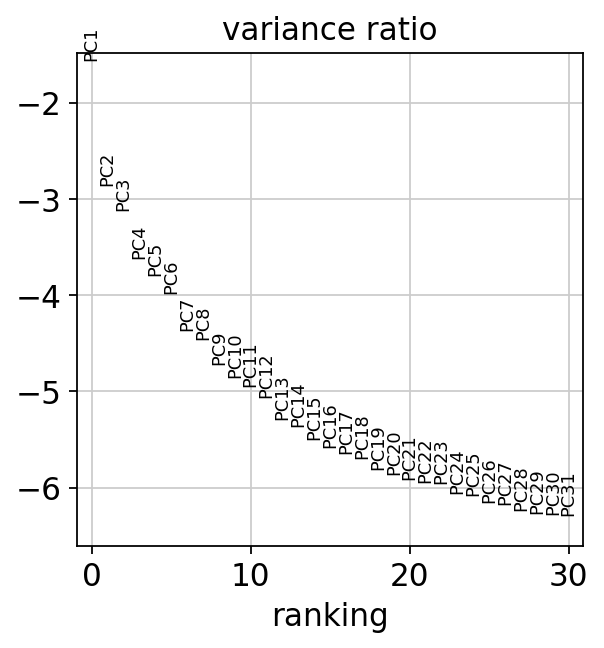

In [36]:
# Plot the variance ratio
sc.pl.pca_variance_ratio(cellcycle_adata, log=True, save='_ccg_identification.pdf')

computing neighbors
    using 'X_pca' with n_pcs = 9
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:02)
... storing 'sample' as categorical
... storing 'technology' as categorical
... storing 'tissue' as categorical
... storing 'dev_age' as categorical
... storing 'donor' as categorical
... storing 'dataset' as categorical
... storing 'celltype_predictions' as categorical
... storing 'souporcell_assignment' as categorical
... storing 'phase' as categorical
... storing 'origin_M_F' as categorical
... storing 'coarse_annot' as categorical
... storing 'cell_type' as categorical


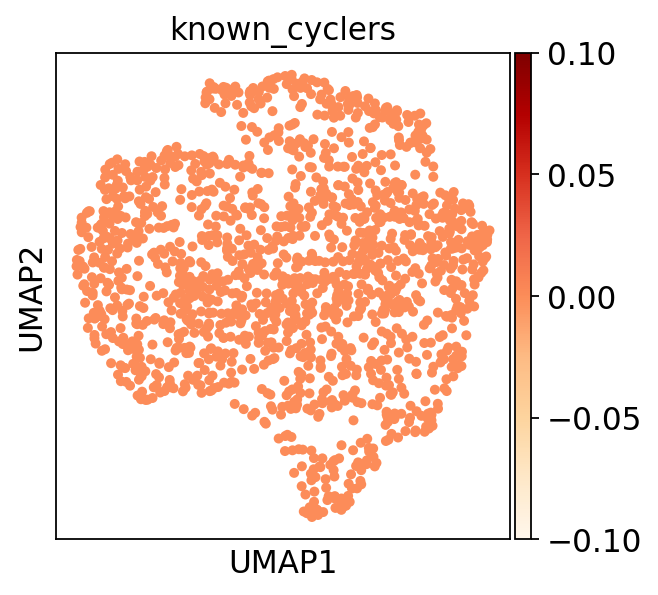

In [37]:
# Identify genes behaving like cc genes
num_pcs = 9
# Compute a neighborhood graph of observations
sc.pp.neighbors(cellcycle_adata,n_pcs=num_pcs)
# Embed the neighborhood graph using UMAP
sc.tl.umap(cellcycle_adata)
cellcycle_adata.obs['known_cyclers'] = [1 if gene in ['CDK1','MKI67','CCNB2','PCNA'] else 0 for gene in cellcycle_adata.obs_names]
# Scatter plot in UMAP basis
sc.pl.umap(cellcycle_adata,color=['known_cyclers'],color_map='OrRd',save='_ccg_identification.pdf')

running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished: found 12 clusters and added
    'louvain', the cluster labels (adata.obs, categorical) (0:00:00)


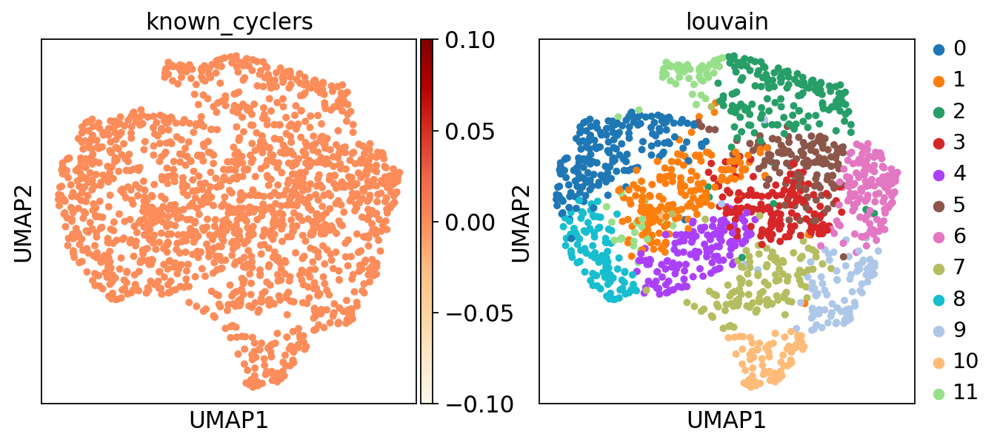

In [38]:
# Cluster GENES into subgroups using louvain
sc.tl.louvain(cellcycle_adata, resolution=1.0)
# Scatter plot in UMAP basis
sc.pl.umap(cellcycle_adata,color=['known_cyclers',
                                  'louvain'],color_map='OrRd',save='_ccg_identification.pdf')

In [39]:
for gene in ['CDK1','MKI67','CCNB2','PCNA']:
    print(gene, 'in current features:', gene in cellcycle_adata.obs_names)

CDK1 in current features: False
MKI67 in current features: False
CCNB2 in current features: False
PCNA in current features: False


In [32]:
# Locate genes of interests' cluster
print(cellcycle_adata.obs.loc[['CDK1','MKI67',
                               #'CCNB2','PCNA',
                              ],'louvain'])


KeyError: "None of [Index(['CDK1', 'MKI67'], dtype='object')] are in the [index]"

In [33]:
cellcycle_adata.obs['louvain'].value_counts()

0     211
1     194
2     173
3     156
4     144
5     110
6     104
7     104
8      91
9      85
10     82
11     34
Name: louvain, dtype: int64

In [34]:
adata

AnnData object with n_obs × n_vars = 378558 × 7848
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cells-15', 'gene_ids-16', 'feature

Not removing any genes here - seems like all CC-assoc genes have been removed with the soupy genes prior to this

# Subsetting to HVGs & scaling

In [40]:
%%time
sc.pp.highly_variable_genes(adata_copy, min_mean=0.0125, max_mean=3, min_disp=0.5)

extracting highly variable genes
    finished (0:00:22)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


CPU times: user 22.2 s, sys: 730 ms, total: 22.9 s
Wall time: 22.9 s


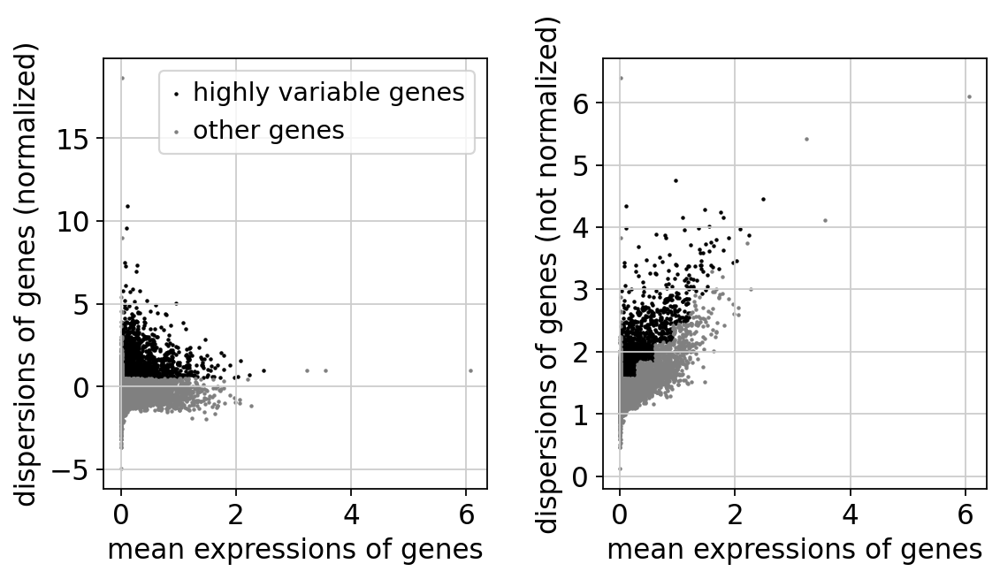

CPU times: user 350 ms, sys: 8.16 ms, total: 358 ms
Wall time: 356 ms


In [41]:
%%time
sc.pl.highly_variable_genes(adata_copy)

In [42]:
adata_copy_hvg = adata_copy[:, adata_copy.var['highly_variable']]

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [43]:
adata_copy_hvg

View of AnnData object with n_obs × n_vars = 350815 × 1381
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01', 'coarse_annot', 'cell_type'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 

In [44]:
%%time
sc.pp.scale(adata_copy_hvg, max_value=10)

/opt/conda/lib/python3.8/site-packages/scanpy/preprocessing/_simple.py:810: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)
... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


CPU times: user 7.97 s, sys: 4.32 s, total: 12.3 s
Wall time: 12.3 s


________

### PCA

In [45]:
%%time
sc.tl.pca(adata_copy_hvg, svd_solver='arpack', n_comps=50)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:54)


CPU times: user 4min 52s, sys: 41.3 s, total: 5min 33s
Wall time: 54.5 s


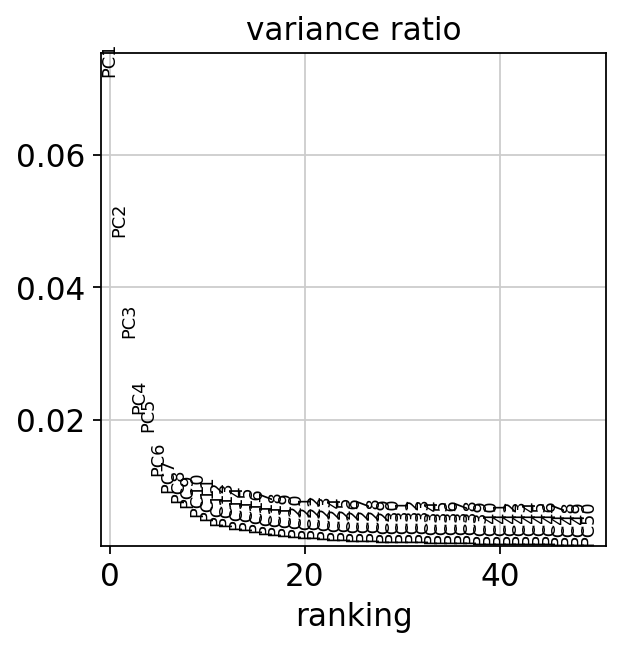

In [46]:
sc.pl.pca_variance_ratio(adata_copy_hvg, n_pcs=50)

In [47]:
# decision: using n_latent = 14 and 20 in scVI

From here following to run scVI in: `/nfs/team292/aa22/scVI_related/202111_upd_in_vivo_analysis/all_donors_analysis/scVI_integration.ipynb`

___________

Carrying on to 
- Normalise and log transform
- Save raw attribute to then be able to plot all genes on the HVG-subsetted dataset
- Make cell names (obs) and gene names (var) unique

In [29]:
# normalise and log transform
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

# saving the raw attribute
adata.raw = adata.copy()

adata.var_names_make_unique()
adata.obs_names_make_unique()

normalizing by total count per cell
    finished (0:00:17): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


_____________________________________________________________________________________________________________________________________________________________

In [30]:
# Assign cell cycle stage & scores
cell_cycle_genes = [x.strip() for x in open(file='/home/jovyan/notebooks/Vento_Lab/regev_lab_cell_cycle_genes_from_Luz_20200505.txt')]
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
s_genes = [x for x in s_genes if x in adata.var_names]
g2m_genes = [x for x in g2m_genes if x in adata.var_names]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    504 total control genes are used. (0:00:18)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    504 total control genes are used. (0:00:14)
-->     'phase', cell cycle phase (adata.obs)


In [31]:
adata

AnnData object with n_obs × n_vars = 350815 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01', 'coarse_annot', 'cell_type'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cell

_______________________________________________________________________________________________________

# Read in scVI-calculated latent representation

In [32]:
# in this case we only used 5 PCs, but also experimented with the layers
n_latent = [14,20]
n_layers = [3]

### 15.11.2021 run, correction by `sample`

In [29]:
latent_representations = {}

for n_latent_value in n_latent:
    print(n_latent_value)
    
    curr_path = '/nfs/team292/aa22/scVI_related/202111_upd_in_vivo_analysis/all_donors_analysis/results/20211111_obsm_with_scVI_latent_representation_n_' + str(n_latent_value) + '_after_CCG_removal_and_all_doublet_exclusion_by_sample_all_cells_and_nuclei_FINAL_manifold_with_LF_gene_filter_n_layers_3.csv'
    latent_representations[n_latent_value] = pd.read_csv(curr_path, index_col=0)
    

14
20


In [30]:
# assign these latent_representations into adata.obsm
for n_latent_value in n_latent:
    print(n_latent_value)
    adata.obsm['X_scVI_n_latent_' + str(n_latent_value) + '_sample_n_layers_3'] = np.array(latent_representations[n_latent_value])
    

14
20


In [31]:
adata.obsm['X_scVI_n_latent_14_sample_n_layers_3'].shape

(350815, 14)

__________________________________________________________________________________________________________________________________________________________________

### Neighbourhood graph & UMAP

In [32]:
%%time

for n_latent_value in n_latent:
    print(n_latent_value)
    sc.pp.neighbors(adata, n_neighbors=10, use_rep='X_scVI_n_latent_' + str(n_latent_value) + '_sample_n_layers_3',
               key_added='neighbors_scVI_n_latent_' + str(n_latent_value) + '_sample_n_layers_3')

computing neighbors


14


    finished: added to `.uns['neighbors_scVI_n_latent_14_sample_n_layers_3']`
    `.obsp['neighbors_scVI_n_latent_14_sample_n_layers_3_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_14_sample_n_layers_3_connectivities']`, weighted adjacency matrix (0:01:02)
computing neighbors


20


    finished: added to `.uns['neighbors_scVI_n_latent_20_sample_n_layers_3']`
    `.obsp['neighbors_scVI_n_latent_20_sample_n_layers_3_distances']`, distances for each pair of neighbors
    `.obsp['neighbors_scVI_n_latent_20_sample_n_layers_3_connectivities']`, weighted adjacency matrix (0:00:49)


CPU times: user 3min 19s, sys: 9min 15s, total: 12min 34s
Wall time: 1min 52s


In [33]:
adata

AnnData object with n_obs × n_vars = 350815 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01', 'coarse_annot', 'cell_type'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cell

__________________________________________________________________________________________________________________________________________________________________

In [34]:
%%time
# takes a few minutes
for n_latent_value in n_latent:
    print(n_latent_value)
    
    sc.tl.umap(adata, random_state=0,
              neighbors_key='neighbors_scVI_n_latent_' + str(n_latent_value) + '_sample_n_layers_3')
    # copy current adata.obsm['X_umap'] into adata.obsm['X_umap_scVI_n_latent_' + str(n_latent_value)]
    adata.obsm['X_umap_scVI_n_latent_' + str(n_latent_value) + '_sample_n_layers_3'] = adata.obsm['X_umap']
    
    

computing UMAP


14


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:05:33)
computing UMAP


20


    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:05:41)


CPU times: user 59min 55s, sys: 21min 50s, total: 1h 21min 45s
Wall time: 11min 15s


In [35]:
np.unique(adata.obs['sample'], return_counts=True)

(array(['FCA7167219', 'FCA7167221', 'FCA7167222', 'FCA7167223',
        'FCA7167224', 'FCA7167226', 'FCA7167230', 'FCA7167231',
        'FCA7167232', 'FCA7196218', 'FCA7196219', 'FCA7196220',
        'FCA7196224', 'FCA7196225', 'FCA7196226', 'FCA7196229',
        'FCA7196231', 'FCA7474062', 'FCA7474063', 'FCA7474064',
        'FCA7474065', 'FCA7474066', 'FCA7474068', 'FCA7474069',
        'FCA7511881', 'FCA7511882', 'FCA7511883', 'FCA7511884',
        'FCA7511885', 'FCA7511886', 'Pla_Camb10691970', 'Pla_Camb10691971',
        'Pla_Camb10691972', 'Pla_Camb10691975', 'Pla_Camb10714918',
        'Pla_Camb10714919', 'Pla_Camb10714920', 'Pla_HDBR10142767',
        'Pla_HDBR10142768', 'Pla_HDBR10142769', 'Pla_HDBR10142770',
        'Pla_HDBR10142863', 'Pla_HDBR10142864', 'Pla_HDBR10142865',
        'Pla_HDBR10701666', 'Pla_HDBR10701667', 'Pla_HDBR10701668',
        'Pla_HDBR10917730', 'Pla_HDBR10917731', 'Pla_HDBR10917733',
        'Pla_HDBR8624430', 'Pla_HDBR8624431', 'Pla_HDBR8715512',
   

In [86]:
adata

AnnData object with n_obs × n_vars = 350815 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01', 'coarse_annot', 'cell_type'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cell

## Saving this object with all the manifolds calculated

In [37]:
adata.write(save_path + 'adata_scVI_analysed_corr_by_sample_final_all_cells_and_nuclei_with_LF_gene_filter_20211116.h5ad')


... storing 'sample' as categorical
... storing 'technology' as categorical
... storing 'tissue' as categorical
... storing 'dev_age' as categorical
... storing 'donor' as categorical
... storing 'dataset' as categorical
... storing 'celltype_predictions' as categorical
... storing 'souporcell_assignment' as categorical
... storing 'phase' as categorical
... storing 'origin_M_F' as categorical
... storing 'coarse_annot' as categorical
... storing 'cell_type' as categorical


In [5]:
# reading the previously saved file
adata = sc.read(save_path + 'adata_scVI_analysed_corr_by_sample_final_all_cells_and_nuclei_with_LF_gene_filter_20211116.h5ad')


In [6]:
# to better distinguish predictions from Vento-Tormo dataset
colors_VT = ['#C1B4A7','#E8D6E0','#40ab5d','#F4BF73','#F7B5A4',
                 '#d8e7a4','#2ECCFA','#39728C','#FA5858','#E9A1C7',
                 '#B40486','#004529','#C49A6C','#9255a0', '#58595B', '#A3A8AD',
                 '#F6D8CE','#633A6D','#C7E0BD','#49ABC8', '#E7C949', '#F7F297', '#af9e56',
                 '#ED1B64','#E59C24','#C2E8F6','#677EB2','#73FDD6', '#BC3122', '#771A15',
                 '#E6C6F7','#CEE3F6','#CECEF6','#677EB2','#6363A5','#63A585',
                 '#246D66','#9B8579']

In [35]:
colors_VT[list(np.unique(adata.obs['celltype_predictions'])).index('12_F1')]

'#F4BF73'

In [36]:
colors_VT[list(np.unique(adata.obs['celltype_predictions'])).index('33_F2')]

'#771A15'

### scVI-corrected by `sample`

n_latent = 14, n_layers = 3

# This is the final manifold

### Please use this object to plot marker gene expression, in adata.X are the normalised and log transformed count values

In [6]:
curr_embedding_key = 'X_umap_scVI_n_latent_14_sample_n_layers_3'

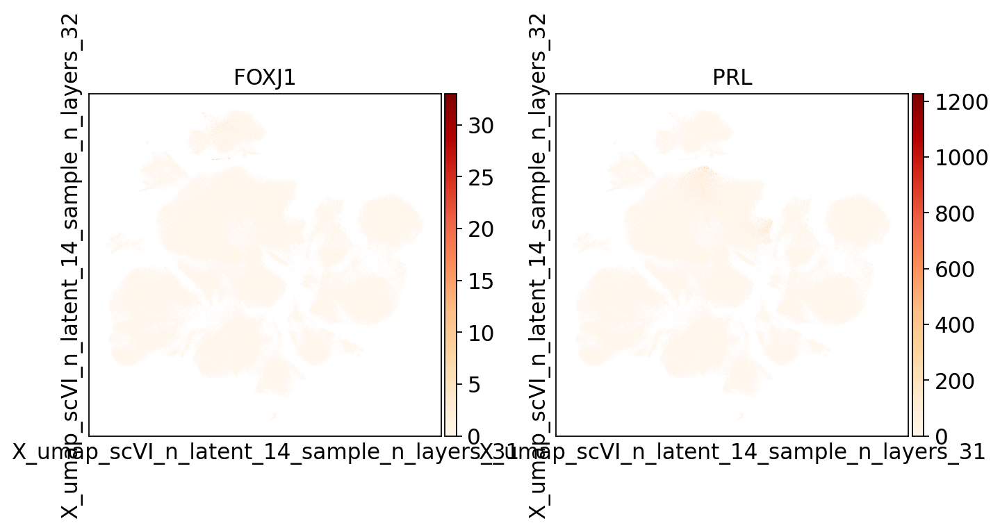

In [8]:
sc.pl.embedding(adata, curr_embedding_key, use_raw=True,
                color=['FOXJ1','PRL'], cmap='OrRd')

In [24]:
import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42

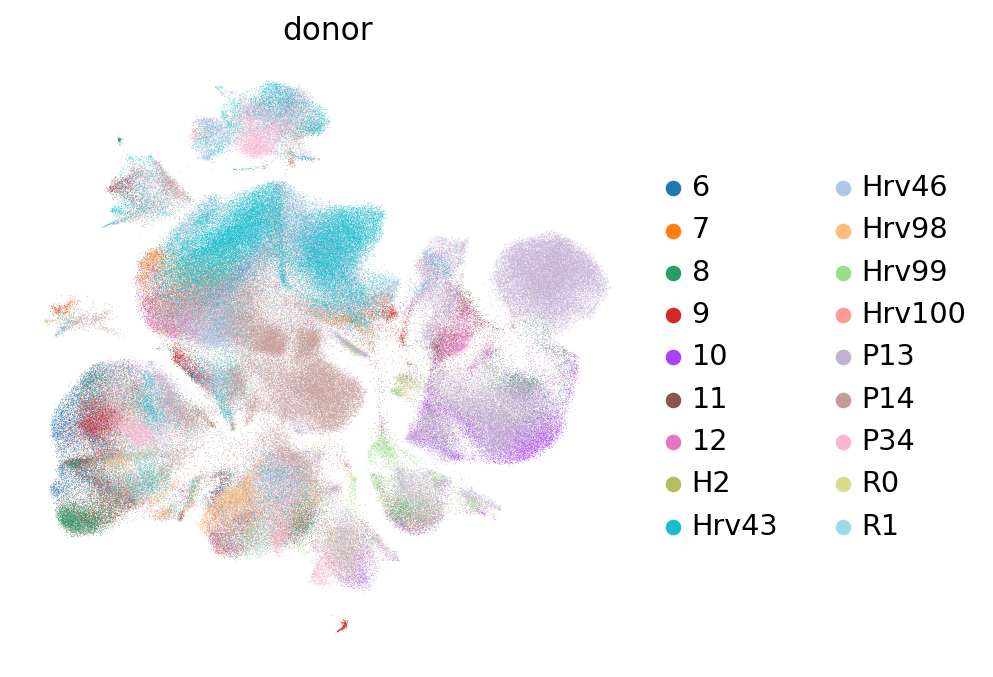

In [25]:
sc.set_figure_params(figsize=(5,5), dpi_save=300)
sc.pl.embedding(adata, curr_embedding_key,
                frameon=False,
                color=['donor'],
               save='_donor_batch_all_donors.pdf')

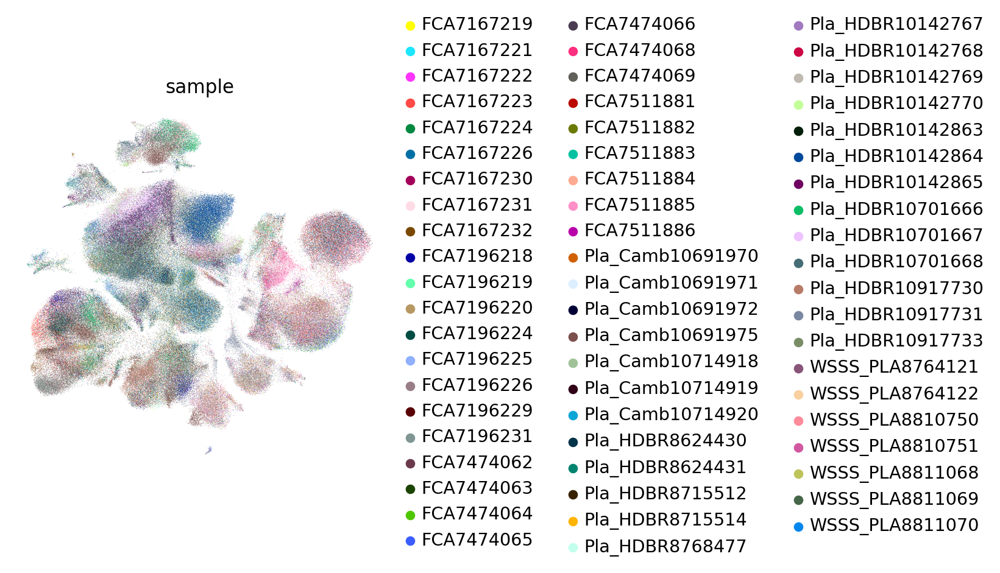

In [26]:
sc.set_figure_params(figsize=(5,5), dpi_save=300)
sc.pl.embedding(adata, curr_embedding_key,
                frameon=False,
                color=['sample'],
               save='_sample_batch_all_donors.pdf')

In [16]:
adata.uns['dev_age_colors']

['#1f77b4',
 '#ff7f0e',
 '#279e68',
 '#d62728',
 '#aa40fc',
 '#8c564b',
 '#e377c2',
 '#b5bd61',
 '#17becf',
 '#aec7e8',
 '#ffbb78']

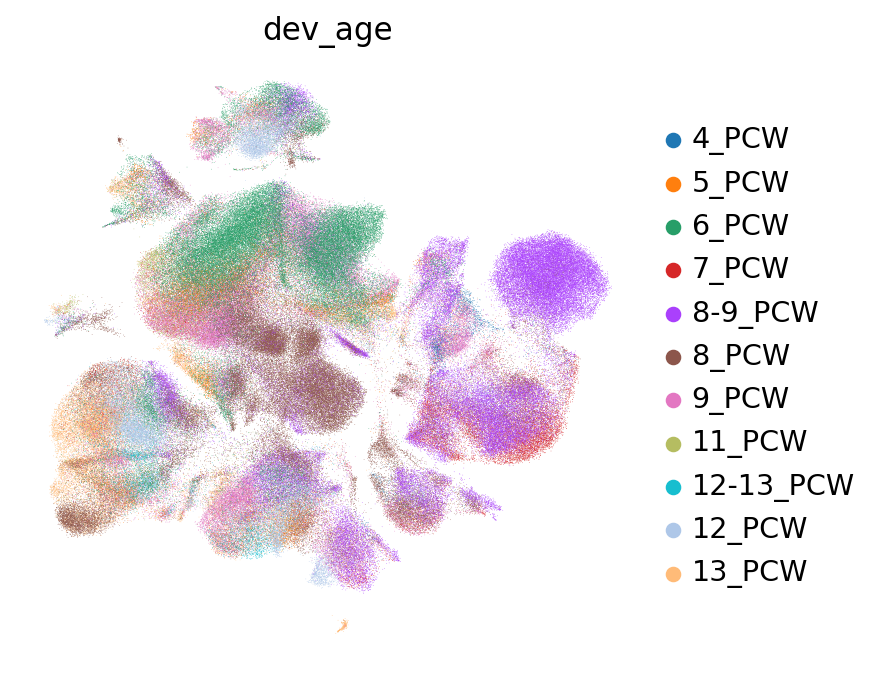

In [27]:
sc.set_figure_params(figsize=(5,5), dpi_save=300)
sc.pl.embedding(adata, curr_embedding_key,
                frameon=False, #palette = 'OrRd',
                palette = ['#1f77b4',
                             '#ff7f0e',
                             '#279e68',
                             '#d62728',
                             '#aa40fc',
                             '#8c564b',
                             '#e377c2',
                             '#b5bd61',
                             '#17becf',
                             '#aec7e8',
                             '#ffbb78'],
                color=['dev_age'],
               save='_dev_age_batch_all_donors.pdf')

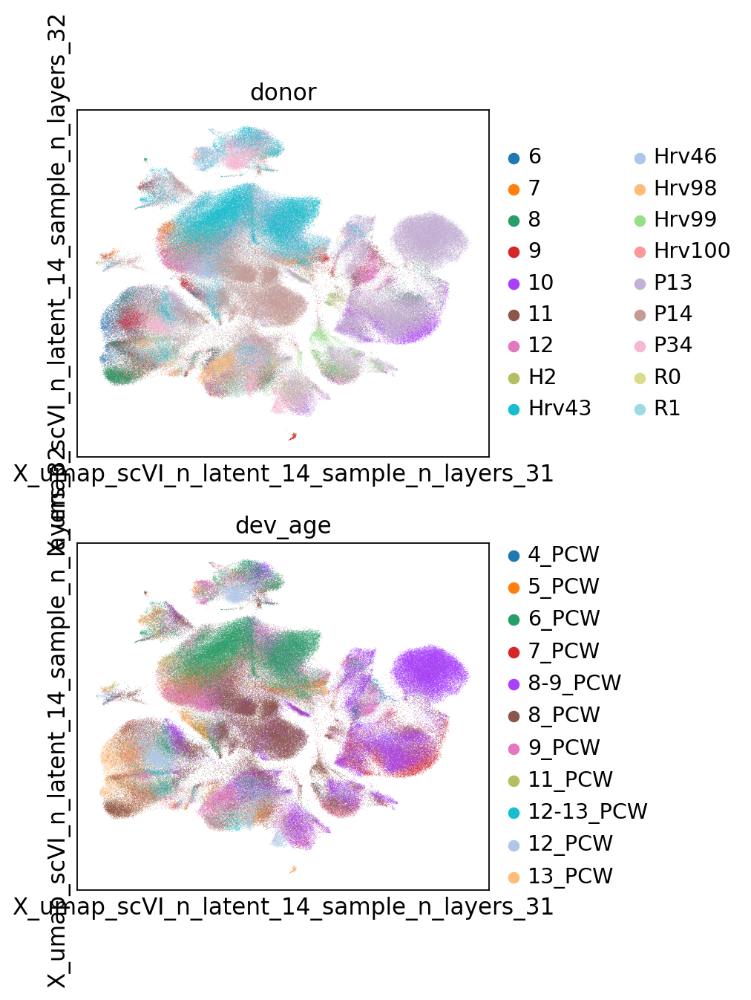

In [12]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dev_age'], ncols=1)

In [9]:
adata

AnnData object with n_obs × n_vars = 350815 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01', 'coarse_annot', 'cell_type'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cell

In [10]:
len(np.unique(adata.obs['donor']))

18

In [14]:
for donor in np.unique(adata.obs['donor']):
    print(donor)
    curr_adata = adata[adata.obs['donor'] == donor]
    print('PC age:', np.unique(curr_adata.obs['dev_age']))
    print('tissues:', np.unique(curr_adata.obs['tissue']))
    
    print('\n')

10
PC age: ['7_PCW']
tissues: ['decidua_immune' 'decidua_non_immune' 'placenta']


11
PC age: ['4_PCW']
tissues: ['placenta']


12
PC age: ['9_PCW']
tissues: ['decidua_immune' 'decidua_non_immune' 'placenta']


6
PC age: ['13_PCW']
tissues: ['blood' 'decidua_immune' 'decidua_non_immune']


7
PC age: ['11_PCW']
tissues: ['blood' 'decidua_immune' 'decidua_non_immune']


8
PC age: ['8_PCW']
tissues: ['blood' 'decidua_immune' 'decidua_non_immune' 'placenta']


9
PC age: ['13_PCW']
tissues: ['blood' 'decidua_immune' 'decidua_non_immune' 'placenta']


H2
PC age: ['12_PCW']
tissues: ['decidua']


Hrv100
PC age: ['5_PCW']
tissues: ['placenta']


Hrv43
PC age: ['6_PCW']
tissues: ['decidua']


Hrv46
PC age: ['9_PCW']
tissues: ['decidua']


Hrv98
PC age: ['9_PCW']
tissues: ['placenta']


Hrv99
PC age: ['8_PCW']
tissues: ['placenta']


P13
PC age: ['8-9_PCW']
tissues: ['decidua_placenta_myometrium']


P14
PC age: ['8_PCW']
tissues: ['decidua_myometrium']


P34
PC age: ['12_PCW']
tissues: ['decidua

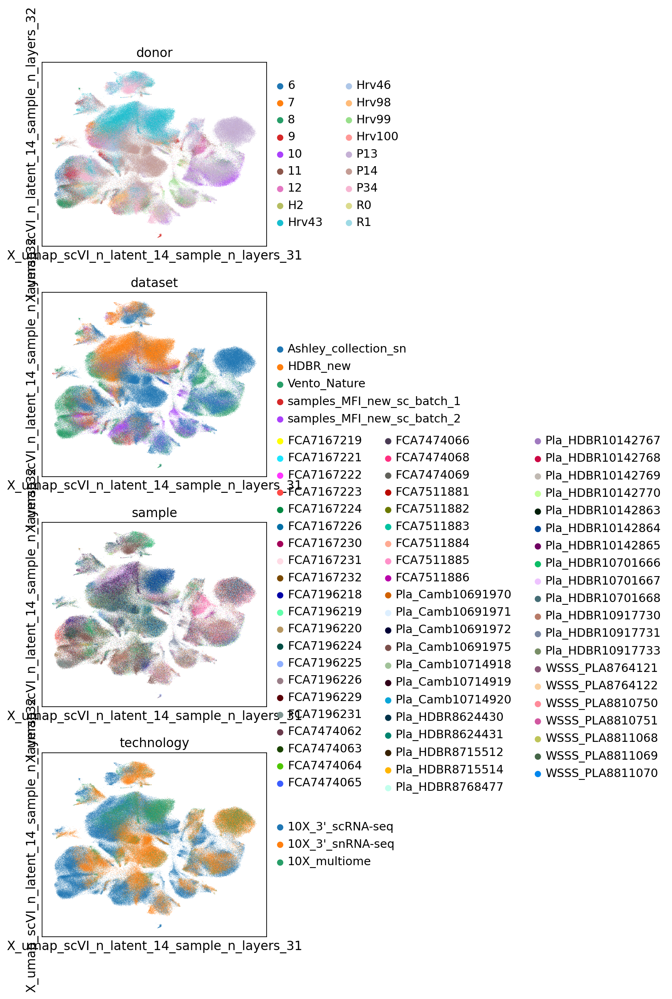

In [40]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['donor','dataset','sample','technology'], ncols=1)

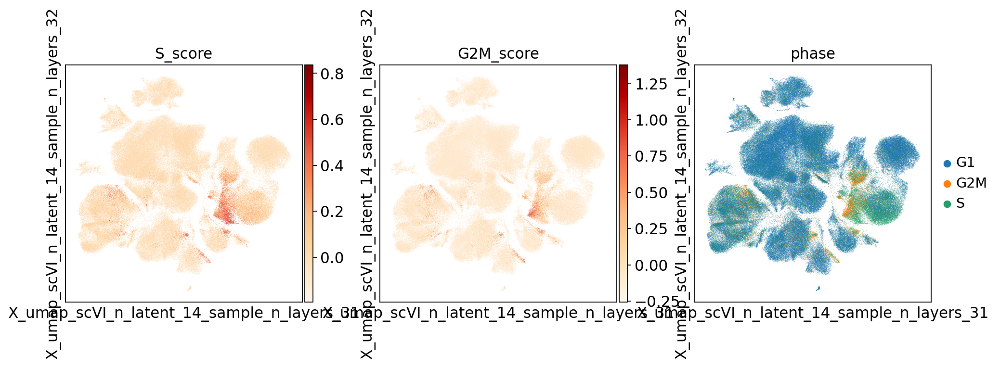

In [41]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['S_score','G2M_score','phase'], cmap='OrRd')

In [7]:
# read in most up-to-date annotation
annot_upd = pd.read_csv(save_path + 'final_annotation_all_cells_and_nulcei_20211123.csv', index_col=0)
adata.obs['cell_type'] = annot_upd.loc[adata.obs_names,'cell_type']

#sc.pl.embedding(adata, curr_embedding_key,
#                color=['cell_type'], ncols=1)

In [12]:
adata

AnnData object with n_obs × n_vars = 350815 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01', 'coarse_annot', 'cell_type'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cell

In [7]:
# producing Suppl table 3 with total numbers of cell states in all samples
# 2 sheets - 1 with all cell states and 2 specifically with all trophoblast cell states

ct_stats_all = df_stats = pd.DataFrame(columns=list(np.unique(adata.obs['cell_type'])),
                     index=list(np.unique(adata.obs['sample'])))

ct_stats_trophoblast = df_stats = pd.DataFrame(columns=['SCT','VCT_fusing','VCT_p','VCT','VCT_CCC','EVT_1','EVT_2','iEVT','GC','eEVT'],
                     index=list(np.unique(adata.obs['sample'])))



In [9]:
for ct in ct_stats_all.columns:
    print('ct', ct)
    for sample in ct_stats_all.index:
        #print(sample)
        ct_stats_all.loc[sample, ct] = adata[(adata.obs['cell_type'] == ct)
                                         & (adata.obs['sample'] == sample)].X.shape[0]

ct B_cells
ct DC
ct EVT_1
ct EVT_2
ct Endo_F
ct Endo_L
ct Endo_M
ct GC
ct Granulocytes
ct HOFB
ct ILC3
ct M3
ct MO
ct NK
ct PV
ct Plasma
ct SCT
ct T_cells
ct VCT
ct VCT_CCC
ct VCT_fusing
ct VCT_p
ct dDC
ct dEpi_lumenal
ct dEpi_secretory
ct dM1
ct dM2
ct dNK1
ct dNK2
ct dNK3
ct dS1
ct dS2
ct dS3
ct dT_cells
ct dT_regs
ct eEVT
ct fF1
ct fF2
ct iEVT
ct uSMC


In [11]:
ct_stats_all

,B_cells,DC,EVT_1,EVT_2,Endo_F,Endo_L,Endo_M,GC,Granulocytes,HOFB,...,dS1,dS2,dS3,dT_cells,dT_regs,eEVT,fF1,fF2,iEVT,uSMC
FCA7167219,2,1,0,1,1,0,3,0,4,2,...,27,3,0,49,6,0,0,0,0,4
FCA7167221,0,2,0,1,0,0,2,0,0,13,...,42,8,2,100,11,0,0,0,1,0
FCA7167222,0,1,8,0,9,67,34,0,0,3,...,805,400,59,4,0,0,0,0,5,28
FCA7167223,2,4,0,1,0,1,2,0,20,19,...,130,11,2,558,70,0,1,0,0,2
FCA7167224,0,0,6,2,40,38,407,0,0,3,...,171,205,114,5,1,0,18,8,5,15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
WSSS_PLA8810750,7,2,236,156,103,13,109,1,1,547,...,213,279,5,5,2,5,169,95,175,690
WSSS_PLA8810751,1,1,210,142,84,17,71,1,1,429,...,153,222,4,2,1,6,121,71,141,522
WSSS_PLA8811068,7,12,0,1,59,217,461,0,4,145,...,4621,2187,75,7,2,0,3,1,1,3550
WSSS_PLA8811069,6,6,0,2,69,217,515,0,3,150,...,5034,2174,68,6,3,0,4,1,4,4013


In [10]:
for ct in ct_stats_trophoblast.columns:
    print('ct', ct)
    ct_stats_trophoblast.loc[:, ct] = ct_stats_all.loc[ct_stats_trophoblast.index,ct]

ct SCT
ct VCT_fusing
ct VCT_p
ct VCT
ct VCT_CCC
ct EVT_1
ct EVT_2
ct iEVT
ct GC
ct eEVT


In [ ]:
# producing proportion plots for supplementary fig1C
# sep for SC and SN+multiome

In [30]:
adata.obs['technology'].value_counts()

10X_3'_scRNA-seq    188619
10X_3'_snRNA-seq    120049
10X_multiome         42147
Name: technology, dtype: int64

In [31]:
adata.obs['SC_or_SN'] = ['nulcei' if technology in ["10X_3'_snRNA-seq","10X_multiome"] else 'cells' for technology in adata.obs['technology']]
adata.obs['SC_or_SN'].value_counts()

cells     188619
nulcei    162196
Name: SC_or_SN, dtype: int64

In [32]:
df_stats = pd.DataFrame(columns=list(np.unique(adata.obs['cell_type'])),
                     index=list(np.unique(adata.obs['SC_or_SN'])))

In [33]:
df_stats

,B_cells,DC,EVT_1,EVT_2,Endo_F,Endo_L,Endo_M,GC,Granulocytes,HOFB,...,dS1,dS2,dS3,dT_cells,dT_regs,eEVT,fF1,fF2,iEVT,uSMC
cells,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
nulcei,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [34]:
for ct in df_stats.columns:
    print('ct', ct)
    for idx in df_stats.index:
        #print(sample)
        df_stats.loc[idx, ct] = adata[(adata.obs['cell_type'] == ct)
                                         & (adata.obs['SC_or_SN'] == idx)].X.shape[0]

ct B_cells


/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


ct DC
ct EVT_1
ct EVT_2
ct Endo_F
ct Endo_L
ct Endo_M
ct GC
ct Granulocytes
ct HOFB
ct ILC3
ct M3
ct MO
ct NK
ct PV
ct Plasma
ct SCT
ct T_cells
ct VCT
ct VCT_CCC
ct VCT_fusing
ct VCT_p
ct dDC
ct dEpi_lumenal
ct dEpi_secretory
ct dM1
ct dM2
ct dNK1
ct dNK2
ct dNK3
ct dS1
ct dS2
ct dS3
ct dT_cells
ct dT_regs
ct eEVT
ct fF1
ct fF2
ct iEVT
ct uSMC


In [43]:
df_stats

,B_cells,DC,EVT_1,EVT_2,Endo_F,Endo_L,Endo_M,GC,Granulocytes,HOFB,...,dS1,dS2,dS3,dT_cells,dT_regs,eEVT,fF1,fF2,iEVT,uSMC
cells,682,600,3947,1148,666,711,3109,0,158,5757,...,24713,35439,11253,9020,1685,2,7750,765,1079,1030
nulcei,92,97,1342,1210,800,1050,3768,19,37,4976,...,17873,30307,1944,720,177,26,2670,631,2597,16013


In [44]:
df_stats = df_stats.T

In [45]:
df_stats_norm = df_stats.div(df_stats.sum(axis=1), axis=0)

In [37]:
#cols_new_order = ['SCT','VCT_fusing','VCT','VCT_CCC','EVT_early','EVT_mid','iEVT','EVT_late']
#df_stats_norm = df_stats_norm[cols_new_order]
#df_stats_norm

In [46]:
len(np.unique(adata.obs['cell_type']))

40

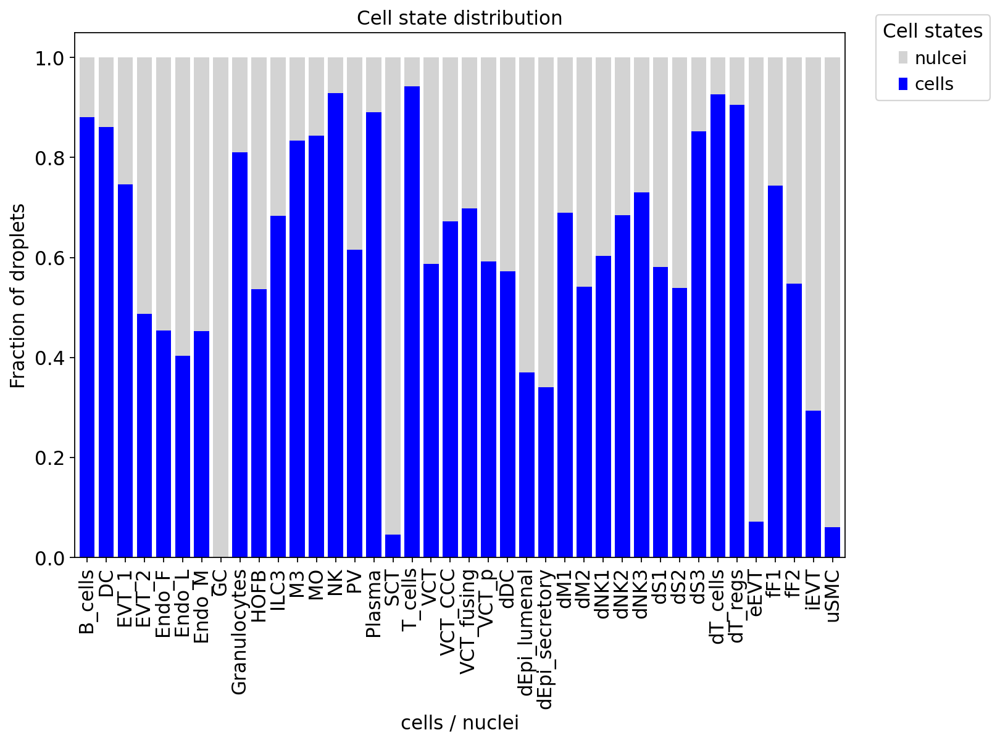

In [55]:
# this is for final cells only

ax = df_stats_norm.plot.bar(stacked=True, figsize=(10,7), width=0.8,
                           color = ['blue','lightgrey'])

handles, labels = ax.get_legend_handles_labels()

ax.legend(handles[::-1],
          labels[::-1], title='Cell states',
          bbox_to_anchor=(1.20, 1.05))

ax.set_xticklabels(labels=df_stats.index)
ax.tick_params(axis='x', rotation=90)

# to turn off the grid
plt.grid(b=None)

plt.title('Cell state distribution')
plt.ylabel('Fraction of droplets')
plt.xlabel('cells / nuclei')

plt.savefig('./figures/20220213_cell_state_distr_vs_cell_states.pdf',
           bbox_inches='tight')

In [ ]:
# dotplot of marker genes from Roser's paper + uSMC marker gene desmin

In [57]:
# main markers from Roser's paper Extended Fig.3 - https://www.nature.com/articles/s41586-018-0698-6/figures/8

#markers_Roser_troph = ['NRP2' # VCT
#                 'TGFB1', # EVT
#                 'CXCR6', # EVT
#                 'ACKR2' # EVT
#                      ]

# further by cell types
markers_Roser = {}

markers_Roser['5_dNK1'] = ['NCAM1', 'ENTPD1', # CD39
                           'KLRB1', 'CD69', 'ITGAX']

markers_Roser['2_dNK2'] = ['NCAM1', 
                         'KLRB1', 'CD69', # more than in dNK1
                         'ITGAX']
markers_Roser['11_dNK3'] = ['KLRB1', 'CD69' # more than in dNK1 and dNK2
                        ]

markers_Roser['24_dNKp'] = ['NCAM1', 'KLRB1', 'CD69', 'ITGAX',
                        'MKI67' # unique amongst dNK
                        ]

markers_Roser['32_ILC3'] = ['KLRB1', 'IL7R', # CD127
                            'CD69']

markers_Roser['31_NK'] = ['KLRB1', 'IL7R', 'CD69']

markers_Roser['17_NK_CD16+'] = ['IL7R', 
                                'FCGR3A' # CD16
                               ]

markers_Roser['7_dM1'] = ['FCGR3A', 'CD14', 'IL1B']

markers_Roser['6_dM2'] = ['FCGR3A', 'CD14', 'CD4']

markers_Roser['22_M3'] = ['FCGR3A', 'CD14', 'CD4', 'PAGE4']


markers_Roser['18_HB'] = ['CD14', 'LYVE1', 'PAGE4']

markers_Roser['23_29_MO'] = ['CD14', 'S100A12', 
                             'PECAM1' # CD31
                            ]

markers_Roser['27_DC1'] = ['CLEC9A', 'LYVE1', 'PAGE4']

markers_Roser['28_DC2'] = ['FCER1A', 'CD1C']

markers_Roser['28_DC2'] = ['FCER1A', 'CD1C']

markers_Roser['30_Granulocytes'] = ['FCER1A', 'CD69','MS4A2']


markers_Roser['T1_dCD4'] = ['KLRB1', 'IL7R', 'CD69','CD3G']
markers_Roser['T2_dCD8'] = ['CD8A','CD3G','CD69']
markers_Roser['T6_Treg'] = ['CD3G','CD69','FOXP3']
markers_Roser['T0_CD4'] = ['IL7R', 'CD69','CD3G']
markers_Roser['T3_CD8'] = ['IL7R', 'CD69','CD3G','CD8A']
markers_Roser['T4_MAIT_gd'] = ['KLRB1', 'IL7R','CD69']

markers_Roser['26_plasma'] = ['FCER1A', 'CD69','IL7R']
markers_Roser['19_1_Endo_m'] = ['ENTPD1', 'PECAM1','COL6A2','MCAM','DKK1','ACTA2','IGFBP1']
markers_Roser['19_2_Endo_I'] = ['LYVE1', 'PECAM1','COL6A2','DKK1','ACTA2','IGFBP1']
markers_Roser['19_3_Endo_f'] = ['LYVE1', 'PECAM1','COL6A2', 'PAGE4']
markers_Roser['25_1_Epi1'] = ['EPCAM', 'IGFBP1','DKK1','ACTA2']
markers_Roser['25_2_Epi2'] = ['EPCAM', 'IGFBP1','DKK1','ACTA2']
markers_Roser['P1_PV1'] = ['COL6A2', 'IGFBP1','ACTA2']
markers_Roser['P2_PV2'] = ['COL6A2', 'IGFBP1','ACTA2']

markers_Roser['0_dS1'] = ['COL6A2','DKK1','ACTA2']
markers_Roser['3_dS2'] = ['COL6A2','DKK1','ACTA2']
markers_Roser['21_dS3'] = ['DKK1','IGFBP1']
markers_Roser['12_F1'] = ['DLK1','ACTA2','COL6A2']
markers_Roser['33_F2'] = ['DLK1','ACTA2','COL6A2']

#markers_Roser['1_VCT'] = ['PAGE4', #++
#                          'GATA3','EGFR']
#markers_Roser['9_VCTp'] = ['PAGE4', #++
#                          'GATA3','EGFR']
#markers_Roser['20_SCT'] = ['PAGE4', #++
#                          'GATA3','EGFR']
#markers_Roser['13_EVT'] = ['GATA3', 'HLA-G']
#markers_Roser['16_EVTp'] = ['GATA3', 'HLA-G', 'PAGE4']


In [59]:
markers_Roser_all = list(markers_Roser.values())
# flatten & make unique
markers_Roser_all = 

In [ ]:
markers_Roser_all

In [61]:
for gene in adata.var_names:
    if 'DES' in gene:
        print(gene)

DES
DESI1
DESI2


In [62]:
# trying to order them according to the order of cell types in Y axis

markers_Roser_all = ['NCAM1', 'ENTPD1', 'KLRB1', 'CD69', 'ITGAX','MKI67',
                     'IL7R','FCGR3A','CD14', 'IL1B','CD4','LYVE1', 'PAGE4',
                     'S100A12', 'PECAM1','CLEC9A','FCER1A', 'CD1C','MS4A2',
                     'CD3G','CD8A','CD69','FOXP3','FCER1A',
                     'ENTPD1', 'COL6A2', 'MCAM', 'DKK1', 'ACTA2', 'IGFBP1', 'DES', # DES for uSMC
                     'EPCAM', 'FOXJ1', # FOXJ1 for epi secretory
                     ]

In [65]:
adata.raw

... storing 'cell_type_for_figure' as categorical


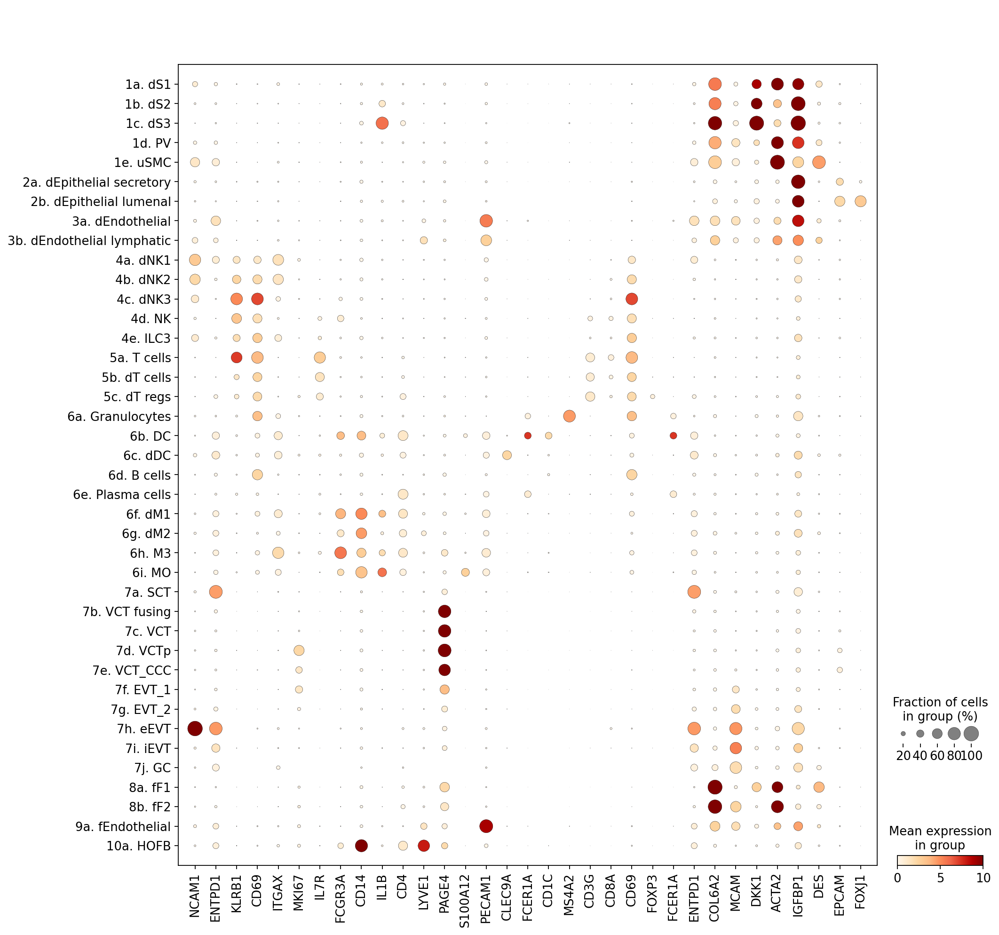

In [74]:
sc.pl.dotplot(adata, var_names = markers_Roser_all, cmap='OrRd', groupby='cell_type_for_figure', use_raw = True, vmax = 10,
             save='_dotplot_all_populations.pdf')

In [7]:
adata[adata.obs['cell_type'] == 'eEVT'].obs['donor'].value_counts()

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


P13      19
Hrv43     6
Hrv46     2
P14       1
Name: donor, dtype: int64

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/opt/conda/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'cell_type' as categorical


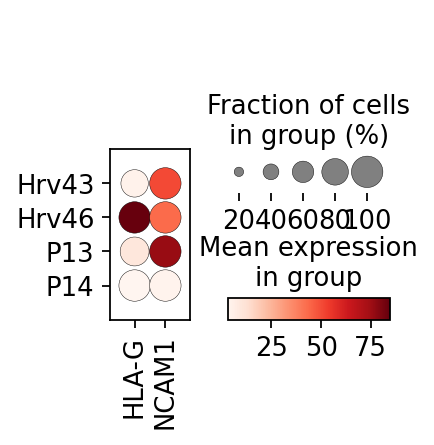

In [8]:
sc.pl.dotplot(adata[adata.obs['cell_type'] == 'eEVT'], groupby='donor', var_names = ['HLA-G','NCAM1'])

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
/opt/conda/lib/python3.8/site-packages/anndata/_core/anndata.py:1207: ImplicitModificationWarning: Initializing view as actual.
  warnings.warn(
Trying to set attribute `.obs` of view, copying.
... storing 'cell_type' as categorical


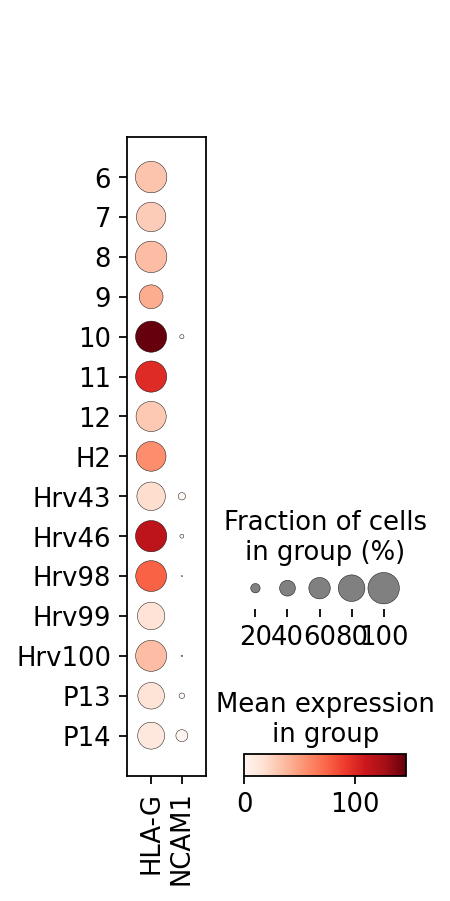

In [9]:
sc.pl.dotplot(adata[adata.obs['cell_type'] == 'iEVT'], groupby='donor', var_names = ['HLA-G','NCAM1'])

In [9]:
# generating a table of M/F composition for Matthew Young

In [19]:
np.unique(adata.obs['origin_M_F'])

array(['F', 'M', 'soc_didnt_work'], dtype=object)

In [21]:
np.unique(adata[adata.obs['origin_M_F'] == 'soc_didnt_work'].obs['sample'])

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


array(['Pla_HDBR8715512', 'Pla_HDBR8715514', 'Pla_HDBR8768477'],
      dtype=object)

In [23]:
# assigning also M/F origin based on cell type annotations where souporcell didn't work
adata.obs['origin_M_F_full'] = adata.obs['origin_M_F']

In [24]:
adata.obs['origin_M_F_full'] = [adata.obs.loc[idx, 'cell_type'] if adata.obs.loc[idx,'origin_M_F_full'] == 'soc_didnt_work' else adata.obs.loc[idx,'origin_M_F_full'] for idx in adata.obs_names]


In [27]:
adata.obs['origin_M_F_full'].value_counts()

M                 247385
F                  99822
dM1                  787
dNK3                 486
dNK2                 407
dT_cells             384
dM2                  294
NK                   206
ILC3                 172
dNK1                 169
MO                   140
T_cells              135
dT_regs               70
HOFB                  56
dS2                   53
B_cells               46
PV                    36
dS1                   33
Endo_M                25
Granulocytes          21
dS3                   21
M3                    15
DC                    11
Endo_L                10
dDC                    9
dEpi_secretory         9
uSMC                   5
Plasma                 3
Endo_F                 2
VCT_CCC                1
VCT                    1
EVT_1                  1
Name: origin_M_F_full, dtype: int64

In [30]:
# tease apart by cell type
adata.obs['origin_M_F_full'] = ['M' if adata.obs.loc[idx,'origin_M_F_full'] in ['B_cells', 'DC', 
                                                                                  #'EVT_1', 
                                                                                  'Endo_F', 'Endo_L', 'Endo_M',
                                                                                  'Granulocytes', 
                                                                                  #'HOFB', 
                                                                                  'ILC3', 'M3', 'MO', 'NK', 'PV', 'Plasma','T_cells', 
                                                                                  #'VCT', 'VCT_CCC', 
                                                                                  'dDC', 'dEpi_secretory', 'dM1', 'dM2','dNK1', 'dNK2', 
                                                                                  'dNK3', 'dS1', 'dS2', 'dS3', 'dT_cells', 'dT_regs','uSMC'] else adata.obs.loc[idx,'origin_M_F_full'] for idx in adata.obs_names]

adata.obs['origin_M_F_full'] = ['F' if adata.obs.loc[idx,'origin_M_F_full'] in ['EVT_1', 'HOFB',
                                                                                  'VCT', 'VCT_CCC'] else adata.obs.loc[idx,'origin_M_F_full'] for idx in adata.obs_names]



In [31]:
adata.obs['origin_M_F_full'].value_counts()

M    250934
F     99881
Name: origin_M_F_full, dtype: int64

In [33]:
adata.obs[['n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor',
       'dataset', 'run', 'number_of_individuals_multiplexed', 'batch',
       'percent_mito', 'n_counts', 'souporcell_assignment', 'inter_ind_doublet',
       'S_score', 'G2M_score', 'phase', 'origin_M_F_full', 'cell_type']].to_csv('/lustre/scratch117/cellgen/team292/sharing/from_aa22/MFI_atlas_obs_table_for_Matthew_Young_20220113.csv')

In [34]:
np.unique(adata[adata.obs['origin_M_F'] == 'soc_didnt_work'].obs['cell_type'])

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


array(['B_cells', 'DC', 'EVT_1', 'Endo_F', 'Endo_L', 'Endo_M',
       'Granulocytes', 'HOFB', 'ILC3', 'M3', 'MO', 'NK', 'PV', 'Plasma',
       'T_cells', 'VCT', 'VCT_CCC', 'dDC', 'dEpi_secretory', 'dM1', 'dM2',
       'dNK1', 'dNK2', 'dNK3', 'dS1', 'dS2', 'dS3', 'dT_cells', 'dT_regs',
       'uSMC'], dtype=object)

In [13]:
# did it just add '-1' to all the UMI tags (barcodes)? --> yes
check_list = [elem.split('-1') for elem in adata.obs_names]
check_list

[['AAACGGGCATTGGCGC', '_FCA7167219'],
 ['AAACGGGTCGCGATCG', '_FCA7167219'],
 ['AAAGATGAGCAATATG', '_FCA7167219'],
 ['AAAGATGAGTTCGCGC', '_FCA7167219'],
 ['AAAGATGCATGTCGAT', '_FCA7167219'],
 ['AAAGATGGTCTCGTTC', '_FCA7167219'],
 ['AAAGCAATCATAACCG', '_FCA7167219'],
 ['AAATGCCTCAAGGTAA', '_FCA7167219'],
 ['AAATGCCTCCCTTGCA', '_FCA7167219'],
 ['AACACGTGTAGATTAG', '_FCA7167219'],
 ['AACCATGCAGCAGTTT', '_FCA7167219'],
 ['AACCATGGTACCGGCT', '_FCA7167219'],
 ['AACCGCGCATAGGATA', '_FCA7167219'],
 ['AACCGCGGTCACACGC', '_FCA7167219'],
 ['AACCGCGTCAGTCCCT', '_FCA7167219'],
 ['AACGTTGTCACCCGAG', '_FCA7167219'],
 ['AACTCAGGTTATGTGC', '_FCA7167219'],
 ['AACTCCCGTCTGATCA', '_FCA7167219'],
 ['AACTCTTCAGGATCGA', '_FCA7167219'],
 ['AACTCTTGTACCATCA', '_FCA7167219'],
 ['AAGACCTAGATGTGGC', '_FCA7167219'],
 ['AAGACCTGTTACGCGC', '_FCA7167219'],
 ['AAGCCGCGTCTAGAGG', '_FCA7167219'],
 ['AAGGTTCAGTTGTAGA', '_FCA7167219'],
 ['AAGGTTCCATGCAATC', '_FCA7167219'],
 ['AAGGTTCGTGCTAGCC', '_FCA7167219'],
 ['AAGGTTCGT

In [14]:
check_list_lens = [len(elem) for elem in check_list]
np.unique(check_list_lens)

array([2])

In [15]:
check_list_lens_0 = [len(elem[0]) for elem in check_list]
np.unique(check_list_lens_0)

array([16])

In [16]:
check_list_lens_1 = [len(elem[1]) for elem in check_list]
np.unique(check_list_lens_1)

array([11, 16, 17])

In [17]:
check_list_1 = [elem[1] for elem in check_list]
np.unique(check_list_1)

array(['_FCA7167219', '_FCA7167221', '_FCA7167222', '_FCA7167223',
       '_FCA7167224', '_FCA7167226', '_FCA7167230', '_FCA7167231',
       '_FCA7167232', '_FCA7196218', '_FCA7196219', '_FCA7196220',
       '_FCA7196224', '_FCA7196225', '_FCA7196226', '_FCA7196229',
       '_FCA7196231', '_FCA7474062', '_FCA7474063', '_FCA7474064',
       '_FCA7474065', '_FCA7474066', '_FCA7474068', '_FCA7474069',
       '_FCA7511881', '_FCA7511882', '_FCA7511883', '_FCA7511884',
       '_FCA7511885', '_FCA7511886', '_Pla_Camb10691970',
       '_Pla_Camb10691971', '_Pla_Camb10691972', '_Pla_Camb10691975',
       '_Pla_Camb10714918', '_Pla_Camb10714919', '_Pla_Camb10714920',
       '_Pla_HDBR10142767', '_Pla_HDBR10142768', '_Pla_HDBR10142769',
       '_Pla_HDBR10142770', '_Pla_HDBR10142863', '_Pla_HDBR10142864',
       '_Pla_HDBR10142865', '_Pla_HDBR10701666', '_Pla_HDBR10701667',
       '_Pla_HDBR10701668', '_Pla_HDBR10917730', '_Pla_HDBR10917731',
       '_Pla_HDBR10917733', '_Pla_HDBR8624430', '_Pla

In [10]:
# checking M/F composition for Matthew Young

for sample in np.unique(adata.obs['sample']):
    curr_subset = adata[adata.obs['sample'] == sample]
    print(sample, np.unique(curr_subset.obs['origin_M_F']))
    print('\n')

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


FCA7167219 ['F' 'M']


FCA7167221 ['F' 'M']


FCA7167222 ['F' 'M']


FCA7167223 ['F' 'M']


FCA7167224 ['F' 'M']


FCA7167226 ['M']


FCA7167230 ['M']


FCA7167231 ['M']


FCA7167232 ['M']


FCA7196218 ['F' 'M']


FCA7196219 ['F' 'M']


FCA7196220 ['F' 'M']


FCA7196224 ['F' 'M']


FCA7196225 ['F' 'M']


FCA7196226 ['F' 'M']


FCA7196229 ['M']


FCA7196231 ['M']


FCA7474062 ['F' 'M']


FCA7474063 ['F' 'M']


FCA7474064 ['F' 'M']


FCA7474065 ['F' 'M']


FCA7474066 ['F' 'M']


FCA7474068 ['F' 'M']


FCA7474069 ['F' 'M']


FCA7511881 ['M']


FCA7511882 ['F' 'M']


FCA7511883 ['F' 'M']


FCA7511884 ['F' 'M']


FCA7511885 ['F' 'M']


FCA7511886 ['F' 'M']


Pla_Camb10691970 ['F' 'M']


Pla_Camb10691971 ['F' 'M']


Pla_Camb10691972 ['F' 'M']


Pla_Camb10691975 ['F' 'M']


Pla_Camb10714918 ['F' 'M']


Pla_Camb10714919 ['F' 'M']


Pla_Camb10714920 ['F' 'M']


Pla_HDBR10142767 ['F' 'M']


Pla_HDBR10142768 ['F' 'M']


Pla_HDBR10142769 ['F' 'M']


Pla_HDBR10142770 ['F' 'M']


Pla_HDBR10142863 ['

In [12]:
# checking M/F composition for Matthew Young

for sample in ['Pla_HDBR10142863',
'Pla_HDBR10142864',
'Pla_HDBR10142865',
'Pla_Camb10691970',
'Pla_Camb10691971',
'Pla_Camb10691972',
'Pla_HDBR10701666',
'Pla_Camb10691973',
'Pla_Camb10691974',
'Pla_Camb10691975',
'Pla_Camb10714918',
'Pla_Camb10714919',
'Pla_Camb10714920']:
    curr_subset = adata[adata.obs['sample'] == sample]
    print(sample, np.unique(curr_subset.obs['origin_M_F']))
    print('\n')

Pla_HDBR10142863 ['M']


Pla_HDBR10142864 ['M']


Pla_HDBR10142865 ['M']


Pla_Camb10691970 ['F' 'M']


Pla_Camb10691971 ['F' 'M']


Pla_Camb10691972 ['F' 'M']


Pla_HDBR10701666 ['F' 'M']


Pla_Camb10691973 []


Pla_Camb10691974 []


Pla_Camb10691975 ['F' 'M']


Pla_Camb10714918 ['F' 'M']


Pla_Camb10714919 ['F' 'M']


Pla_Camb10714920 ['F' 'M']




In [11]:
for sample in ['Pla_HDBR8768477',
               'Pla_HDBR8715512',
               'Pla_HDBR8715514']:
    curr_subset = adata[adata.obs['sample'] == sample]
    print(sample, np.unique(curr_subset.obs['cell_type']))
    print('\n')

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


Pla_HDBR8768477 ['B_cells' 'DC' 'EVT_1' 'Endo_F' 'Endo_L' 'Endo_M' 'Granulocytes' 'HOFB'
 'ILC3' 'M3' 'MO' 'NK' 'PV' 'T_cells' 'dDC' 'dEpi_secretory' 'dM1' 'dM2'
 'dNK1' 'dNK2' 'dNK3' 'dS1' 'dS2' 'dS3' 'dT_cells' 'dT_regs' 'uSMC']


Pla_HDBR8715512 ['Endo_L' 'Endo_M' 'M3' 'NK' 'PV' 'T_cells' 'VCT_CCC' 'dEpi_secretory'
 'dM1' 'dNK1' 'dNK2' 'dNK3' 'dS1' 'dS2' 'dS3' 'dT_cells' 'uSMC']


Pla_HDBR8715514 ['B_cells' 'DC' 'Granulocytes' 'HOFB' 'ILC3' 'M3' 'MO' 'NK' 'Plasma'
 'T_cells' 'VCT' 'dDC' 'dEpi_secretory' 'dM1' 'dM2' 'dNK1' 'dNK2' 'dNK3'
 'dS1' 'dS2' 'dT_cells' 'dT_regs']




/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


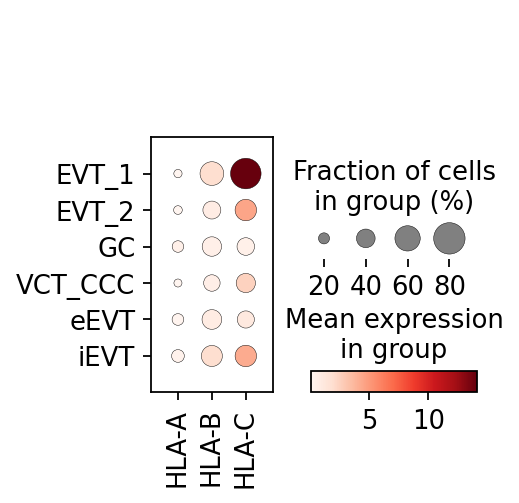

In [12]:
sc.pl.dotplot(adata[adata.obs['cell_type'].isin(['VCT_CCC','EVT_1','EVT_2',
                                                 'eEVT','iEVT','GC'])], 
              groupby='cell_type', var_names=['HLA-A','HLA-B','HLA-C'])

In [10]:
colors_prev_unified = pd.read_csv('/home/jovyan/notebooks/Vento_Lab/MFI_spatial/MFI_sc_sn_Integrated_analysis/old_analysis_harmony_scVI/colors_union_20210915.csv', index_col=0)

In [11]:
colors_prev_unified

,color
B_cells,#e3cee4
DC1,#d5e7f7
DC2,#d6d4eb
EVT_1,#d895ea
EVT_2,#9f6bac
EVT_3,#bf4cea
Endo_F,#b9a96b
Endo_L,#f8f4a8
Endo_M,#eacf68
GC,#DBC7DE


In [39]:
colors_final = ['#e3cee4', # B cells
                '#d6d4eb', # DC aka DC from blood (DC2)
                '#d895ea', # EVT_1
                '#9f6bac', # EVT_2
                '#b9a96b', # Endo_F
                '#f8f4a8', # Endo_L
                '#eacf68', # Endo_M
                '#DBC7DE', # GC
                '#7673ae', # Granulocytes
                '#69b4ce', # HOFB
                '#497c76', # ILC3
                '#cbebf6', # M3
                '#7a8dbb', # MO
                '#7aaf93', # NK aka NK fro,m blood
                '#6b6a6b', # PV
                'yellow', # Plasma - need to find another color
                '#eb5376', # SCT
                '#f8e6df', # T_cells (blood)
                '#ecdbe5', # VCT
                '#e7a3c8', # VCT_CCC
                '#b53279', # VCT_fusing
                '#e96db3', # VCT_p
                '#d5e7f7', # dDC aka DC1 (decidual)
                '#863829', # dEpi_lumenal
                '#c35338', # dEpi_secretory
                '#588198', # dM1
                '#66cef6', # # dM2
                '#deeab1', # dNK1
                '#63b472', # dNK2
                '#2d563c', # dNK3
                '#c9bdb2', # dS1
                '#f5c785', # dS2
                '#eaa944', # dS3
                '#d7587b', # dT_cells
                '#B85E52', # dT_regs
                '#FF1200', # eEVT
                '#cba77e', # fF1
                '#a7958c', # fF2
                '#510058', # iEVT
                '#f37a73', # uSMC
               ]

In [13]:
colors_final_df = pd.DataFrame(index = np.unique(adata.obs['cell_type']))
#colors_final_df['color'] = colors_final

In [14]:
colors_final_df.loc['B_cells', 'color'] = '#e3cee4'
colors_final_df.loc['DC', 'color'] = '#d6d4eb'
colors_final_df.loc['EVT_1', 'color'] = '#d895ea'
colors_final_df.loc['EVT_2', 'color'] = '#9f6bac'
colors_final_df.loc['Endo_F', 'color'] = '#b9a96b'
colors_final_df.loc['Endo_L', 'color'] = '#f8f4a8'
colors_final_df.loc['Endo_M', 'color'] = '#eacf68'
colors_final_df.loc['GC', 'color'] = '#DBC7DE'
colors_final_df.loc['Granulocytes', 'color'] = '#7673ae'
colors_final_df.loc['HOFB', 'color'] = '#69b4ce'
colors_final_df.loc['ILC3', 'color'] = '#497c76'
colors_final_df.loc['M3', 'color'] = '#cbebf6'
colors_final_df.loc['MO', 'color'] = '#7a8dbb'
colors_final_df.loc['NK', 'color'] = '#7aaf93'
colors_final_df.loc['PV', 'color'] = '#6b6a6b'
colors_final_df.loc['Plasma', 'color'] = 'yellow'
colors_final_df.loc['SCT', 'color'] = '#eb5376'
colors_final_df.loc['T_cells', 'color'] = '#f8e6df'
colors_final_df.loc['VCT', 'color'] = '#ecdbe5'
colors_final_df.loc['VCT_CCC', 'color'] = '#e7a3c8'
colors_final_df.loc['VCT_fusing', 'color'] = '#b53279'
colors_final_df.loc['VCT_p', 'color'] = '#e96db3'
colors_final_df.loc['dDC', 'color'] = '#d5e7f7'
colors_final_df.loc['dEpi_lumenal', 'color'] = '#863829'
colors_final_df.loc['dEpi_secretory', 'color'] = '#c35338'
colors_final_df.loc['dM1', 'color'] = '#588198'
colors_final_df.loc['dM2', 'color'] = '#66cef6'
colors_final_df.loc['dNK1', 'color'] = '#deeab1'
colors_final_df.loc['dNK2', 'color'] = '#63b472'
colors_final_df.loc['dNK3', 'color'] = '#2d563c'



colors_final_df.loc['dS1', 'color'] = '#c9bdb2'
colors_final_df.loc['dS2', 'color'] = '#f5c785'
colors_final_df.loc['dS3', 'color'] = '#eaa944'
colors_final_df.loc['dT_cells', 'color'] = '#d7587b'
colors_final_df.loc['dT_regs', 'color'] = '#B85E52'
colors_final_df.loc['eEVT', 'color'] = '#FF1200'
colors_final_df.loc['fF1', 'color'] = '#cba77e'
colors_final_df.loc['fF2', 'color'] = '#a7958c'
colors_final_df.loc['iEVT', 'color'] = '#510058'
colors_final_df.loc['uSMC', 'color'] = '#f37a73'




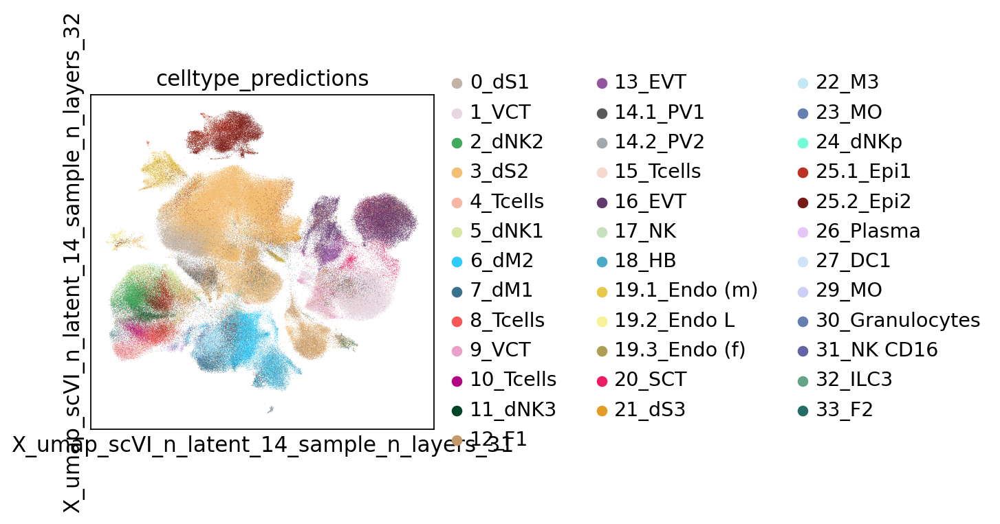

In [22]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['celltype_predictions'], palette=colors_VT)

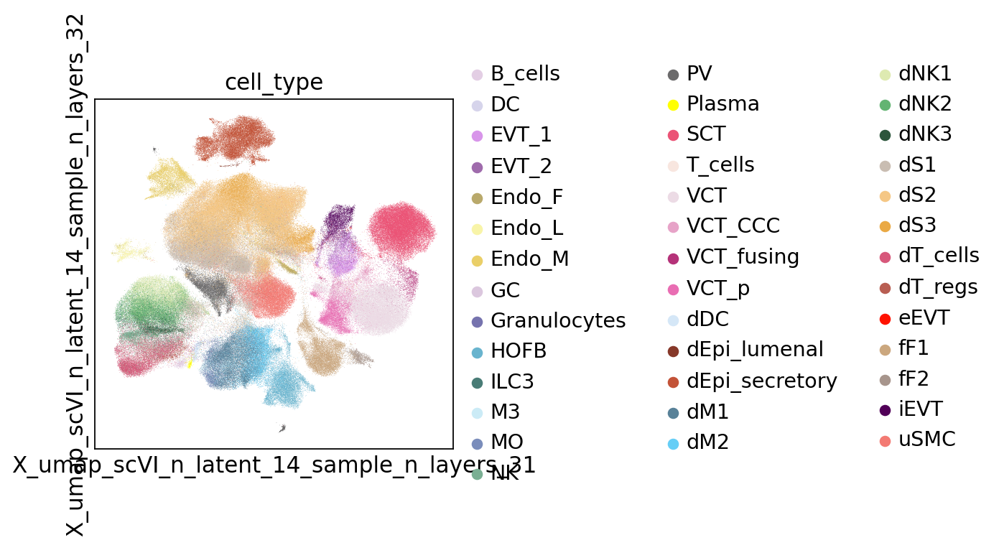

In [18]:
sc.pl.embedding(adata, curr_embedding_key,
                color=['cell_type'], palette=colors_final)

In [21]:
colors_final_df.loc[cts2plot,'color']

dS1     #c9bdb2
dS2     #f5c785
dS3     #eaa944
PV      #6b6a6b
uSMC    #f37a73
Name: color, dtype: object

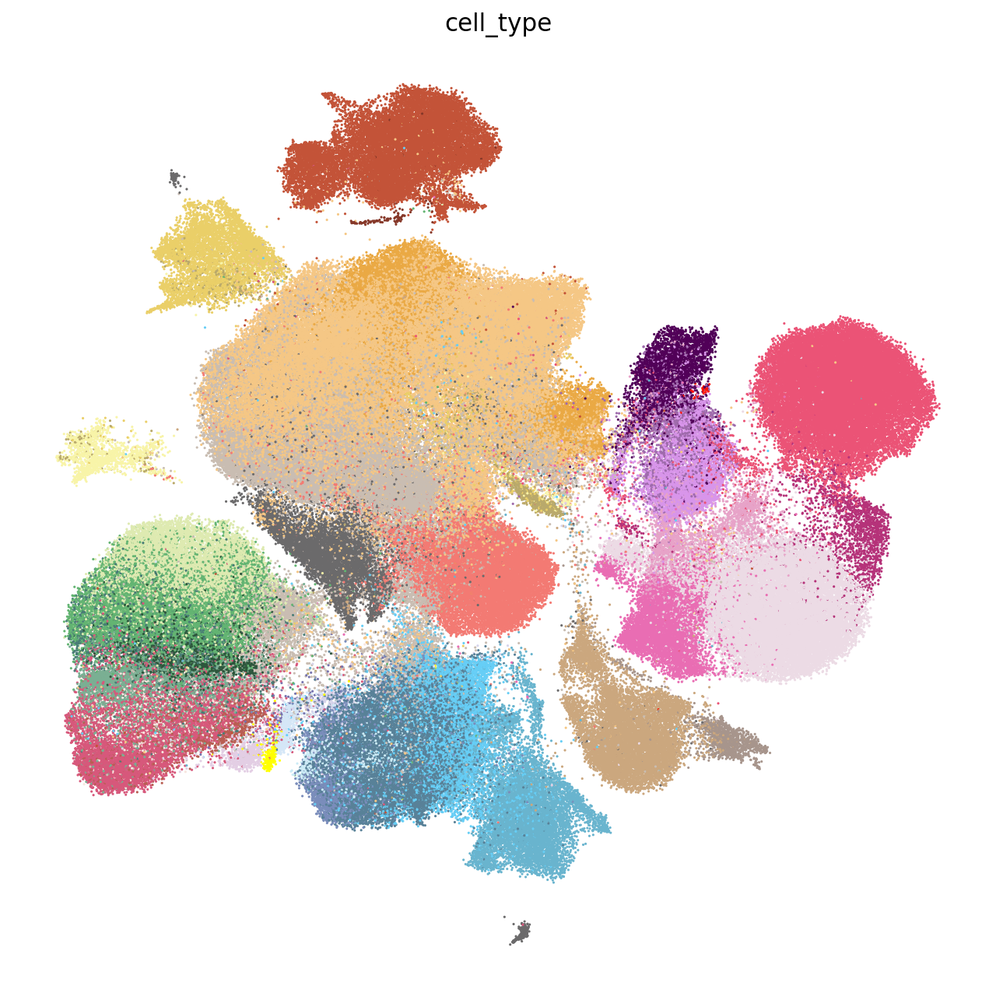

In [34]:
sc.set_figure_params(figsize=(10,10), dpi_save=300)
sc.pl.embedding(adata, curr_embedding_key,
                color=['cell_type'], palette=colors_final, frameon=False, 
                legend_loc=None, 
                legend_fontsize=8,
               size=8, save='_final_cell_types_all_donors.pdf')

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)
Trying to set attribute `.uns` of view, copying.


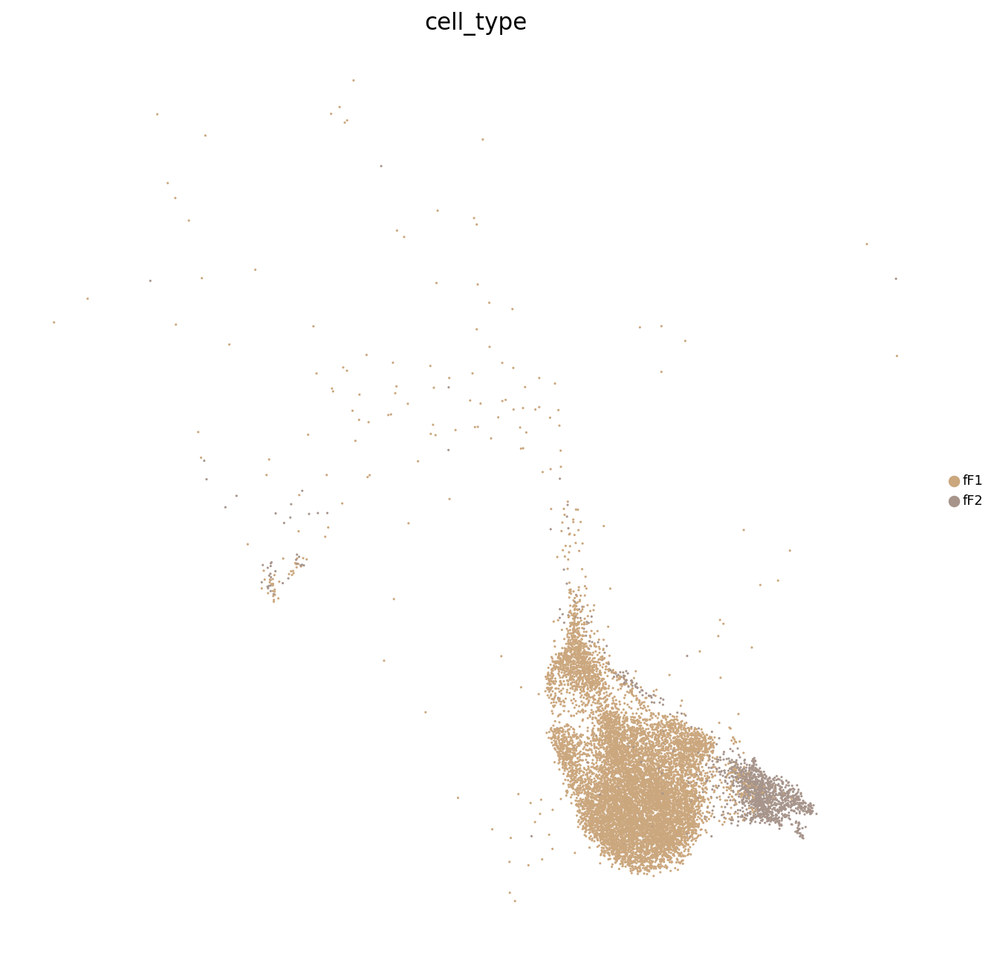

In [30]:
sc.set_figure_params(figsize=(10,10))
cts2plot = ['fF1','fF2']
adata_subset = adata[adata.obs['cell_type'].isin(cts2plot)]
sc.pl.embedding(adata_subset, curr_embedding_key,
                color=['cell_type'], palette=list(colors_final_df.loc[np.unique(adata_subset.obs['cell_type']),'color']), frameon=False, 
                #legend_loc='on data', 
                legend_fontsize=8,
               size=8, 
                #save='_final_cell_types_all_donors.pdf'
               )

In [25]:
np.unique(adata.obs['cell_type'])

array(['B_cells', 'DC', 'EVT_1', 'EVT_2', 'Endo_F', 'Endo_L', 'Endo_M',
       'GC', 'Granulocytes', 'HOFB', 'ILC3', 'M3', 'MO', 'NK', 'PV',
       'Plasma', 'SCT', 'T_cells', 'VCT', 'VCT_CCC', 'VCT_fusing',
       'VCT_p', 'dDC', 'dEpi_lumenal', 'dEpi_secretory', 'dM1', 'dM2',
       'dNK1', 'dNK2', 'dNK3', 'dS1', 'dS2', 'dS3', 'dT_cells', 'dT_regs',
       'eEVT', 'fF1', 'fF2', 'iEVT', 'uSMC'], dtype=object)

In [69]:
# adding numbers for figure ordering
adata.obs['cell_type_for_figure'] = adata.obs['cell_type']

ct2ct_code_figure = {}

ct2ct_code_figure['dS1'] = '1a. dS1'
ct2ct_code_figure['dS2'] = '1b. dS2'
ct2ct_code_figure['dS3'] = '1c. dS3'
ct2ct_code_figure['PV'] = '1d. PV'
ct2ct_code_figure['uSMC'] = '1e. uSMC'

ct2ct_code_figure['dEpi_secretory'] = '2a. dEpithelial secretory'
ct2ct_code_figure['dEpi_lumenal'] = '2b. dEpithelial lumenal'

ct2ct_code_figure['Endo_M'] = '3a. dEndothelial'
ct2ct_code_figure['Endo_L'] = '3b. dEndothelial lymphatic'

ct2ct_code_figure['dNK1'] = '4a. dNK1'
ct2ct_code_figure['dNK2'] = '4b. dNK2'
ct2ct_code_figure['dNK3'] = '4c. dNK3'
ct2ct_code_figure['NK'] = '4d. NK'
ct2ct_code_figure['ILC3'] = '4e. ILC3'

ct2ct_code_figure['T_cells'] = '5a. T cells'
ct2ct_code_figure['dT_cells'] = '5b. dT cells'
ct2ct_code_figure['dT_regs'] = '5c. dT regs'

ct2ct_code_figure['Granulocytes'] = '6a. Granulocytes'
ct2ct_code_figure['DC'] = '6b. DC'
ct2ct_code_figure['dDC'] = '6c. dDC'
ct2ct_code_figure['B_cells'] = '6d. B cells'
ct2ct_code_figure['Plasma'] = '6e. Plasma cells'
ct2ct_code_figure['dM1'] = '6f. dM1'
ct2ct_code_figure['dM2'] = '6g. dM2'
ct2ct_code_figure['M3'] = '6h. M3'
ct2ct_code_figure['MO'] = '6i. MO'


ct2ct_code_figure['SCT'] = '7a. SCT'
ct2ct_code_figure['VCT_fusing'] = '7b. VCT fusing'
ct2ct_code_figure['VCT'] = '7c. VCT'
ct2ct_code_figure['VCT_p'] = '7d. VCTp'
ct2ct_code_figure['VCT_CCC'] = '7e. VCT_CCC'
ct2ct_code_figure['EVT_1'] = '7f. EVT_1'
ct2ct_code_figure['EVT_2'] = '7g. EVT_2'
ct2ct_code_figure['eEVT'] = '7h. eEVT'
ct2ct_code_figure['iEVT'] = '7i. iEVT'
ct2ct_code_figure['GC'] = '7j. GC'

ct2ct_code_figure['fF1'] = '8a. fF1'
ct2ct_code_figure['fF2'] = '8b. fF2'

ct2ct_code_figure['Endo_F'] = '9a. fEndothelial'

ct2ct_code_figure['HOFB'] = '10a. HOFB'


In [70]:
order_cts = list(ct2ct_code_figure.keys())

In [72]:
adata.obs['cell_type_for_figure'] = [ct2ct_code_figure[ct] for ct in adata.obs['cell_type']]
#adata.uns['cell_type_for_figure_colors'] = [colors_final_df.loc[ct,'color'] for ct in order_cts]

In [36]:
adata.uns['cell_type_for_figure_colors']

['#c9bdb2',
 '#f5c785',
 '#eaa944',
 '#6b6a6b',
 '#f37a73',
 '#c35338',
 '#863829',
 '#eacf68',
 '#f8f4a8',
 '#deeab1',
 '#63b472',
 '#2d563c',
 '#7aaf93',
 '#497c76',
 '#f8e6df',
 '#d7587b',
 '#B85E52',
 '#7673ae',
 '#d6d4eb',
 '#d5e7f7',
 '#e3cee4',
 'yellow',
 '#588198',
 '#66cef6',
 '#cbebf6',
 '#7a8dbb',
 '#eb5376',
 '#b53279',
 '#ecdbe5',
 '#e96db3',
 '#e7a3c8',
 '#d895ea',
 '#9f6bac',
 '#FF1200',
 '#510058',
 '#DBC7DE',
 '#cba77e',
 '#a7958c',
 '#b9a96b',
 '#69b4ce']

... storing 'cell_type' as categorical
... storing 'cell_type_for_figure' as categorical


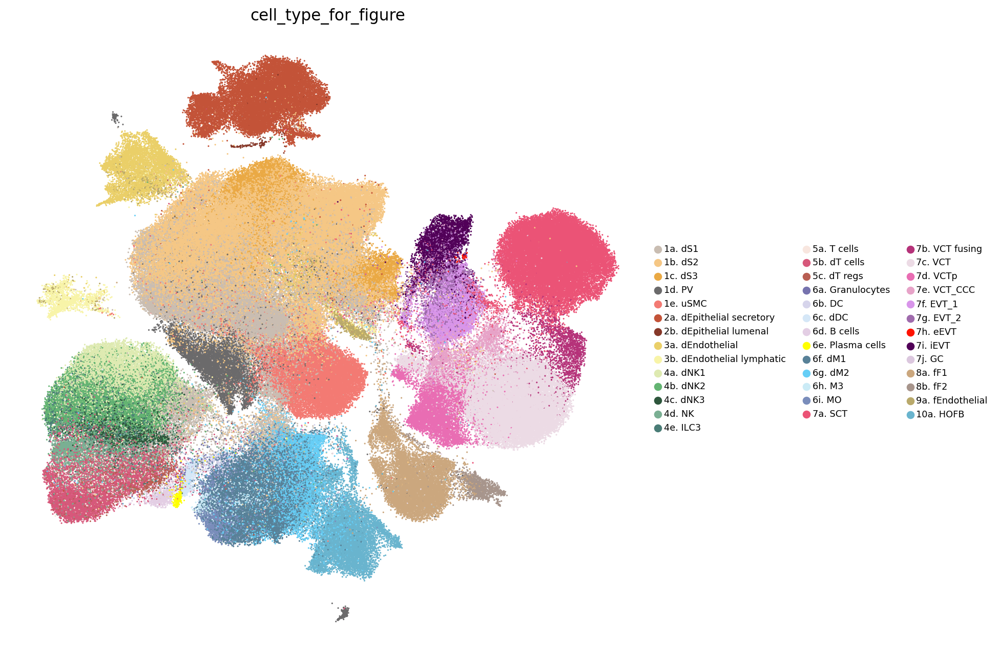

In [37]:
sc.set_figure_params(figsize=(10,10))
sc.pl.embedding(adata, curr_embedding_key,
                color=['cell_type_for_figure'], 
                #palette=colors_final, 
                frameon=False, 
                #legend_loc='on data', 
                legend_fontsize=8,
               size=8, 
                #save='_final_cell_types_all_donors.pdf'
               )

In [18]:
order_cts_figure = list(ct2ct_code_figure.values())

In [19]:
order_cts_figure

['1a. dS1',
 '1b. dS2',
 '1c. dS3',
 '1d. PV',
 '1e. uSMC',
 '2a. dEpithelial secretory',
 '2b. dEpithelial lumenal',
 '3a. dEndothelial',
 '3b. dEndothelial lymphatic',
 '4a. dNK1',
 '4b. dNK2',
 '4c. dNK3',
 '4d. NK',
 '4e. ILC3',
 '5a. T cells',
 '5b. dT cells',
 '5c. dT regs',
 '6a. Granulocytes',
 '6b. DC',
 '6c. dDC',
 '6d. B cells',
 '6e. Plasma cells',
 '6f. dM1',
 '6g. dM2',
 '6h. M3',
 '6i. MO',
 '7a. SCT',
 '7b. VCT fusing',
 '7c. VCT',
 '7d. VCTp',
 '7e. VCT_CCC',
 '7f. EVT_1',
 '7g. EVT_2',
 '7h. eEVT',
 '7i. iEVT',
 '7j. GC',
 '8a. fF1',
 '8b. fF2',
 '9a. fEndothelial',
 '10a. HOFB']

In [20]:
import matplotlib as mpl
mpl.rcParams['pdf.fonttype'] = 42

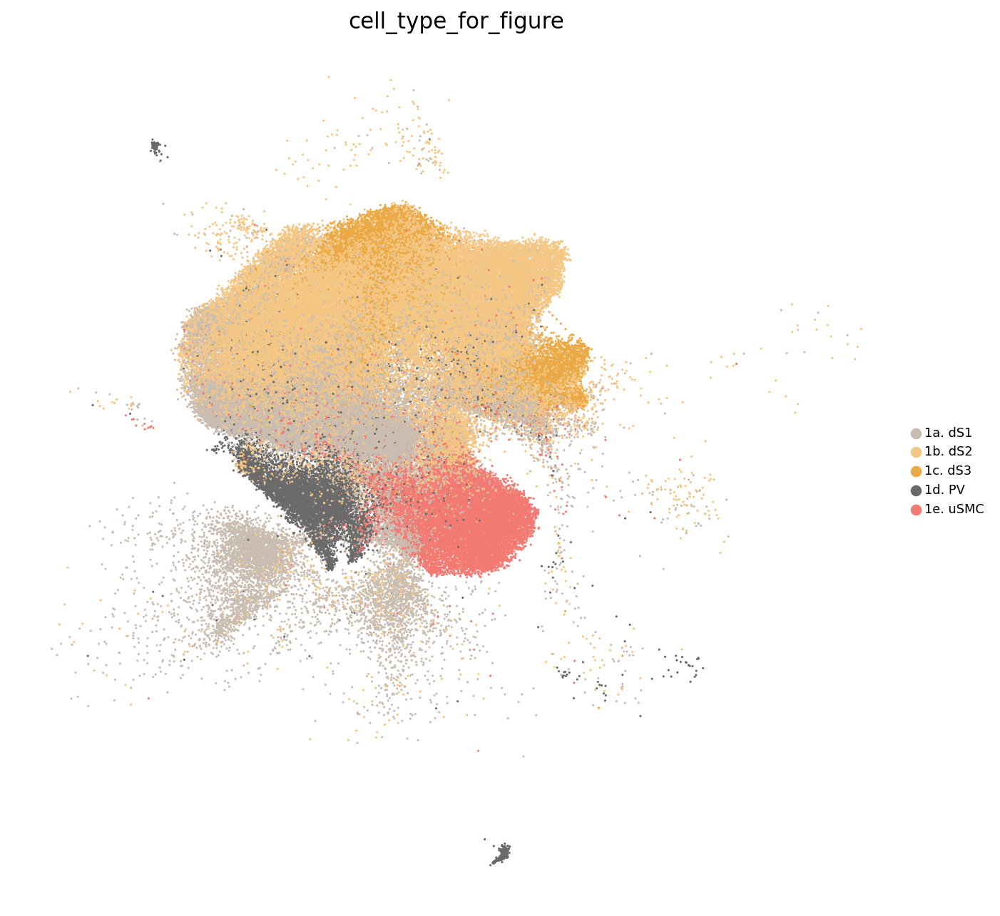

In [38]:
sc.set_figure_params(figsize=(10,10), dpi_save=300)
cts2plot = order_cts_figure[:5]
adata_subset = adata[adata.obs['cell_type_for_figure'].isin(cts2plot)]
sc.pl.embedding(adata_subset, curr_embedding_key,
                color=['cell_type_for_figure'], 
                frameon=False,
                #palette=list(colors_final_df.loc[np.unique(adata_subset.obs['cell_type']),'color']), frameon=False, 
                #legend_loc='on data', 
                legend_fontsize=8,
               size=8, 
                save='_final_cell_types_all_donors_maternal_fibroblast.pdf'
               )

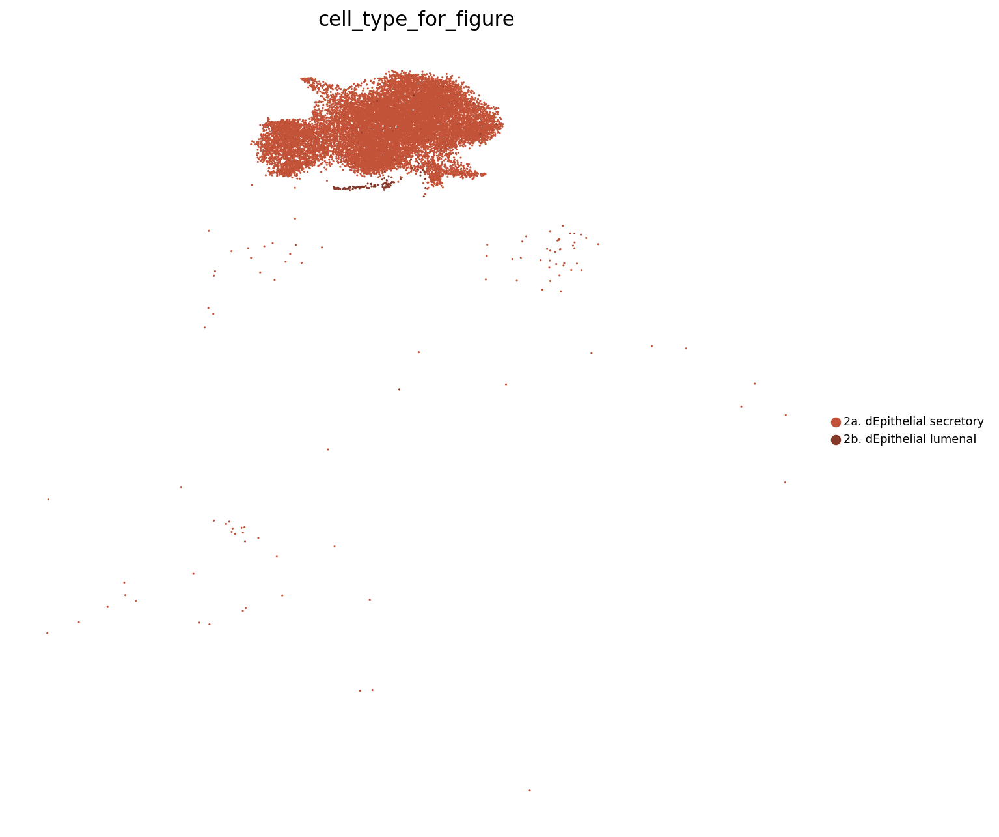

In [40]:
sc.set_figure_params(figsize=(10,10), dpi_save=300)
cts2plot = order_cts_figure[5:7]
adata_subset = adata[adata.obs['cell_type_for_figure'].isin(cts2plot)]
sc.pl.embedding(adata_subset, curr_embedding_key,
                color=['cell_type_for_figure'], 
                frameon=False,
                #palette=list(ct2ct_code_figure),
                #legend_loc='on data', 
                legend_fontsize=8,
               size=8, 
                save='_final_cell_types_all_donors_maternal_epithelial.pdf'
               )

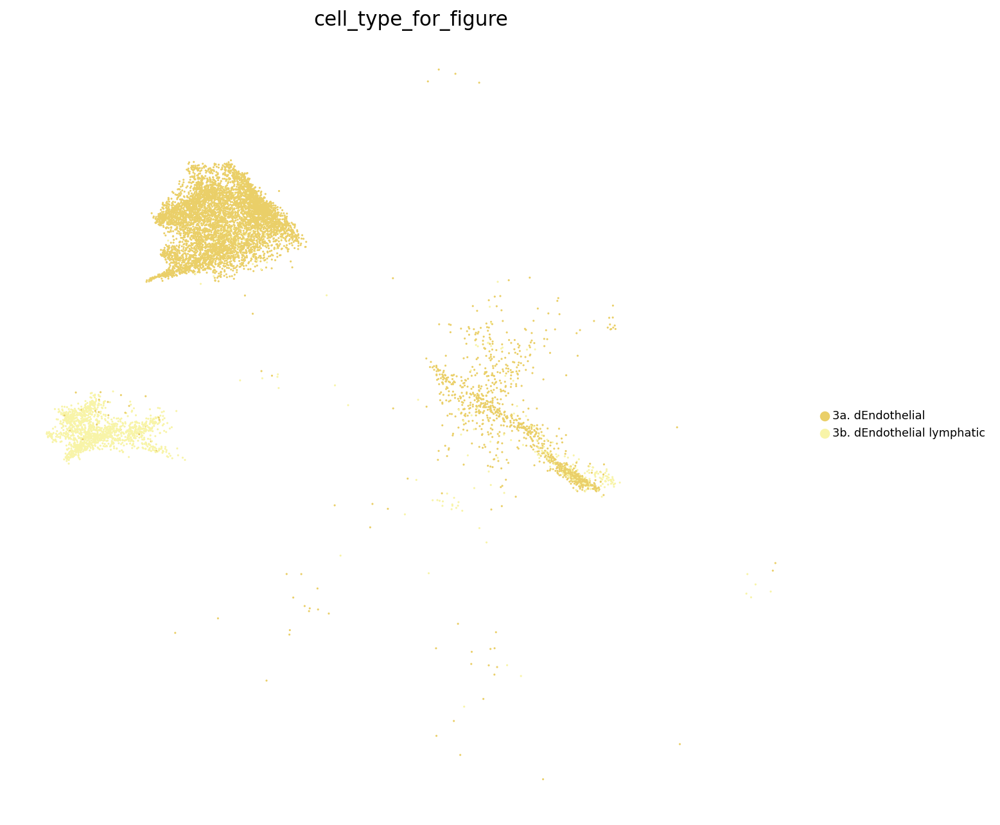

In [41]:
sc.set_figure_params(figsize=(10,10), dpi_save=300)
cts2plot = order_cts_figure[7:9]
adata_subset = adata[adata.obs['cell_type_for_figure'].isin(cts2plot)]
sc.pl.embedding(adata_subset, curr_embedding_key,
                color=['cell_type_for_figure'], 
                frameon=False,
                #palette=list(colors_final_df.loc[np.unique(adata_subset.obs['cell_type']),'color']), frameon=False, 
                #legend_loc='on data', 
                legend_fontsize=8,
               size=8, 
                save='_final_cell_types_all_donors_maternal_endothelial.pdf'
               )

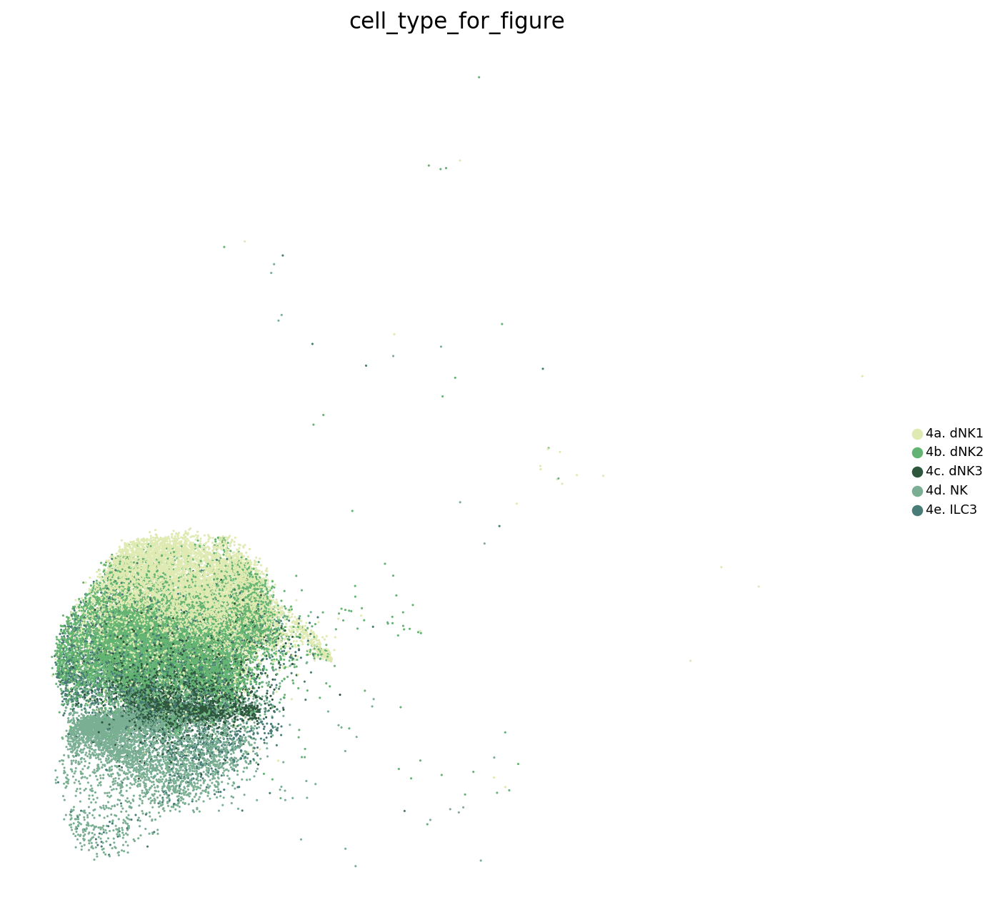

In [42]:
sc.set_figure_params(figsize=(10,10), dpi_save=300)
cts2plot = order_cts_figure[9:14]
adata_subset = adata[adata.obs['cell_type_for_figure'].isin(cts2plot)]
sc.pl.embedding(adata_subset, curr_embedding_key,
                color=['cell_type_for_figure'], 
                frameon=False,
                #palette=list(colors_final_df.loc[np.unique(adata_subset.obs['cell_type']),'color']), frameon=False, 
                #legend_loc='on data', 
                legend_fontsize=8,
               size=8, 
                save='_final_cell_types_all_donors_maternal_NK_ILC.pdf'
               )

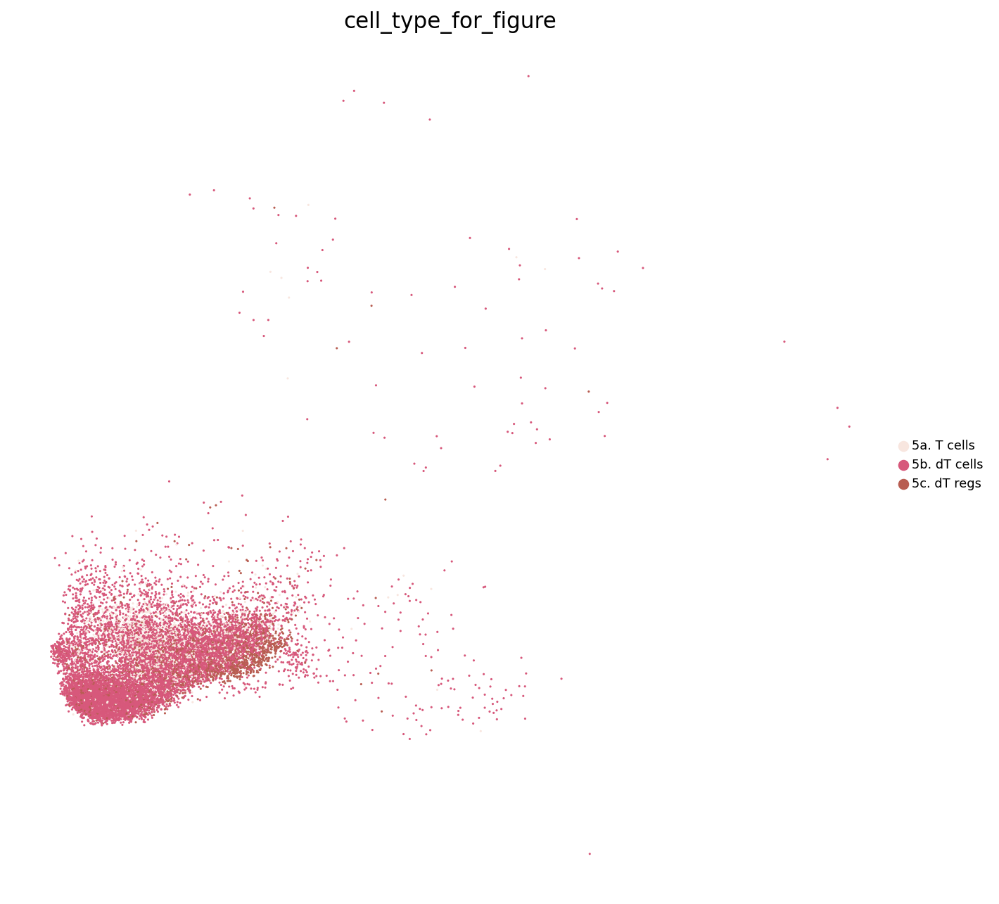

In [43]:
sc.set_figure_params(figsize=(10,10), dpi_save=300)
cts2plot = order_cts_figure[14:17]
adata_subset = adata[adata.obs['cell_type_for_figure'].isin(cts2plot)]
sc.pl.embedding(adata_subset, curr_embedding_key,
                color=['cell_type_for_figure'], 
                frameon=False,
                #palette=list(colors_final_df.loc[np.unique(adata_subset.obs['cell_type']),'color']), frameon=False, 
                #legend_loc='on data', 
                legend_fontsize=8,
               size=8, 
                save='_final_cell_types_all_donors_maternal_T.pdf'
               )

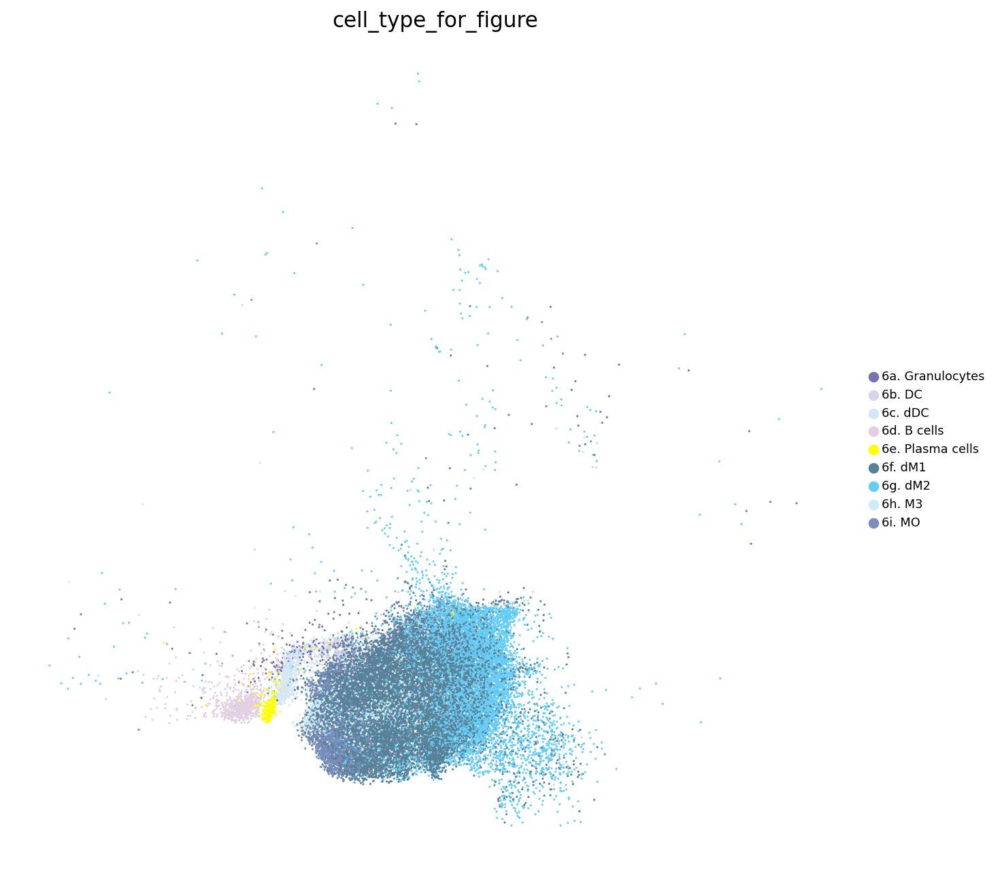

In [44]:
sc.set_figure_params(figsize=(10,10), dpi_save=300)
cts2plot = order_cts_figure[17:26]
adata_subset = adata[adata.obs['cell_type_for_figure'].isin(cts2plot)]
sc.pl.embedding(adata_subset, curr_embedding_key,
                color=['cell_type_for_figure'], 
                frameon=False,
                #palette=list(colors_final_df.loc[np.unique(adata_subset.obs['cell_type']),'color']), frameon=False, 
                #legend_loc='on data', 
                legend_fontsize=8,
               size=8, 
                save='_final_cell_types_all_donors_maternal_Myeloid.pdf'
               )

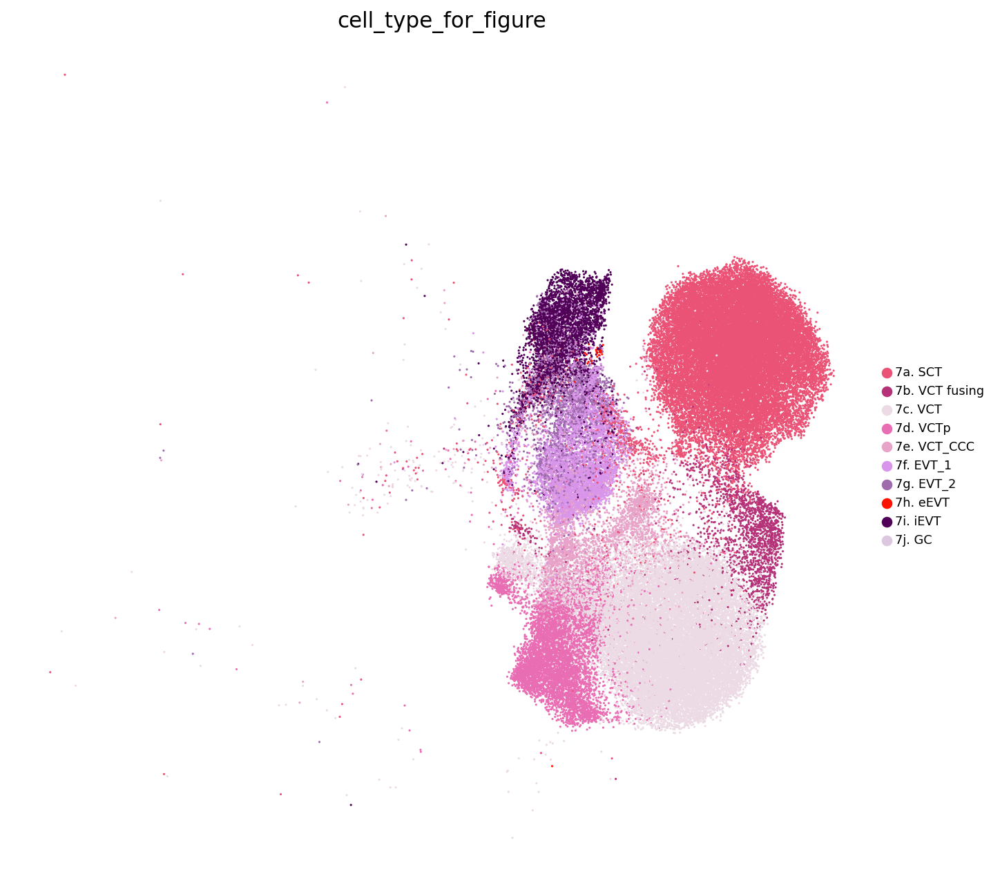

In [45]:
sc.set_figure_params(figsize=(10,10), dpi_save=300)
cts2plot = order_cts_figure[26:36]
adata_subset = adata[adata.obs['cell_type_for_figure'].isin(cts2plot)]
sc.pl.embedding(adata_subset, curr_embedding_key,
                color=['cell_type_for_figure'], 
                frameon=False,
                #palette=list(colors_final_df.loc[np.unique(adata_subset.obs['cell_type']),'color']), frameon=False, 
                #legend_loc='on data', 
                legend_fontsize=8,
               size=8, 
                save='_final_cell_types_all_donors_fetal_Trophoblast.pdf'
               )

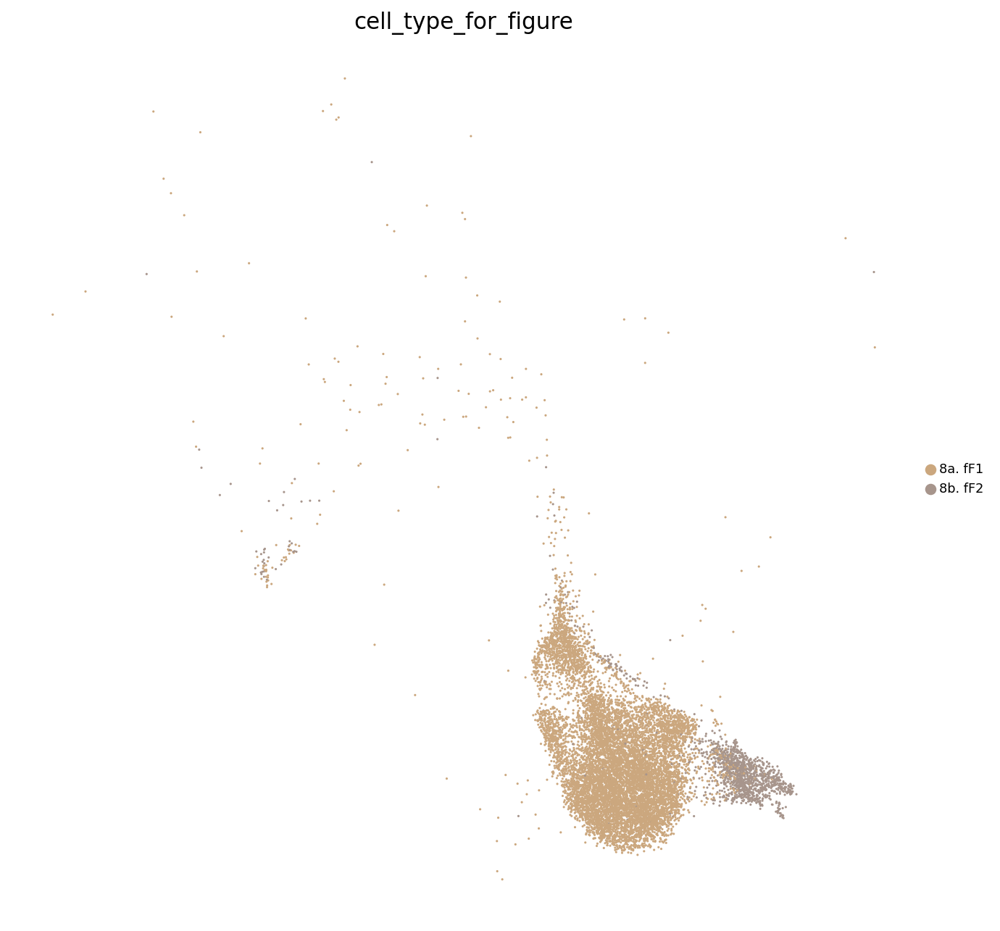

In [46]:
sc.set_figure_params(figsize=(10,10), dpi_save=300)
cts2plot = order_cts_figure[36:38]
adata_subset = adata[adata.obs['cell_type_for_figure'].isin(cts2plot)]
sc.pl.embedding(adata_subset, curr_embedding_key,
                color=['cell_type_for_figure'], 
                frameon=False,
                #palette=list(colors_final_df.loc[np.unique(adata_subset.obs['cell_type']),'color']), frameon=False, 
                #legend_loc='on data', 
                legend_fontsize=8,
               size=8, 
                save='_final_cell_types_all_donors_fetal_fibroblast.pdf'
               )

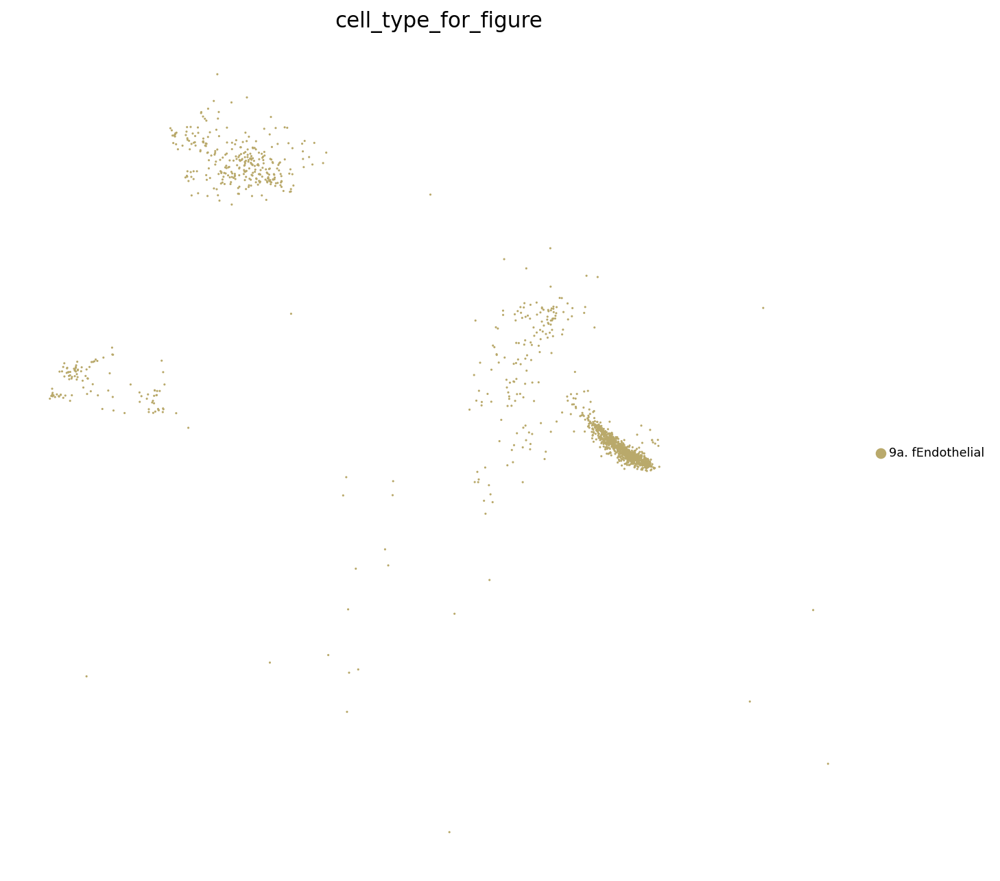

In [47]:
sc.set_figure_params(figsize=(10,10), dpi_save=300)
cts2plot = order_cts_figure[38:39]
adata_subset = adata[adata.obs['cell_type_for_figure'].isin(cts2plot)]
sc.pl.embedding(adata_subset, curr_embedding_key,
                color=['cell_type_for_figure'], 
                frameon=False,
                #palette=list(colors_final_df.loc[np.unique(adata_subset.obs['cell_type']),'color']), frameon=False, 
                #legend_loc='on data', 
                legend_fontsize=8,
               size=8, 
                save='_final_cell_types_all_donors_fetal_endothelial.pdf'
               )

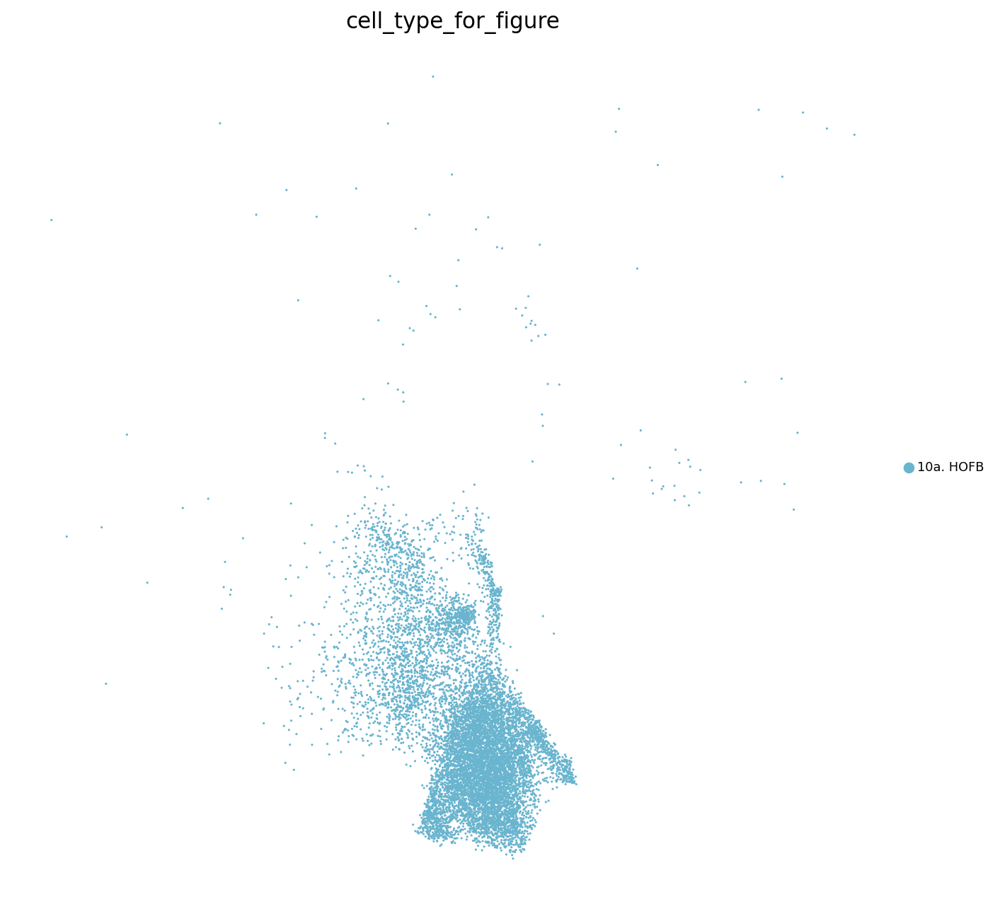

In [48]:
sc.set_figure_params(figsize=(10,10), dpi_save=300)
cts2plot = order_cts_figure[39:40]
adata_subset = adata[adata.obs['cell_type_for_figure'].isin(cts2plot)]
sc.pl.embedding(adata_subset, curr_embedding_key,
                color=['cell_type_for_figure'], 
                frameon=False,
                #palette=list(colors_final_df.loc[np.unique(adata_subset.obs['cell_type']),'color']), frameon=False, 
                #legend_loc='on data', 
                legend_fontsize=8,
               size=8, 
                save='_final_cell_types_all_donors_fetal_HOFB.pdf'
               )

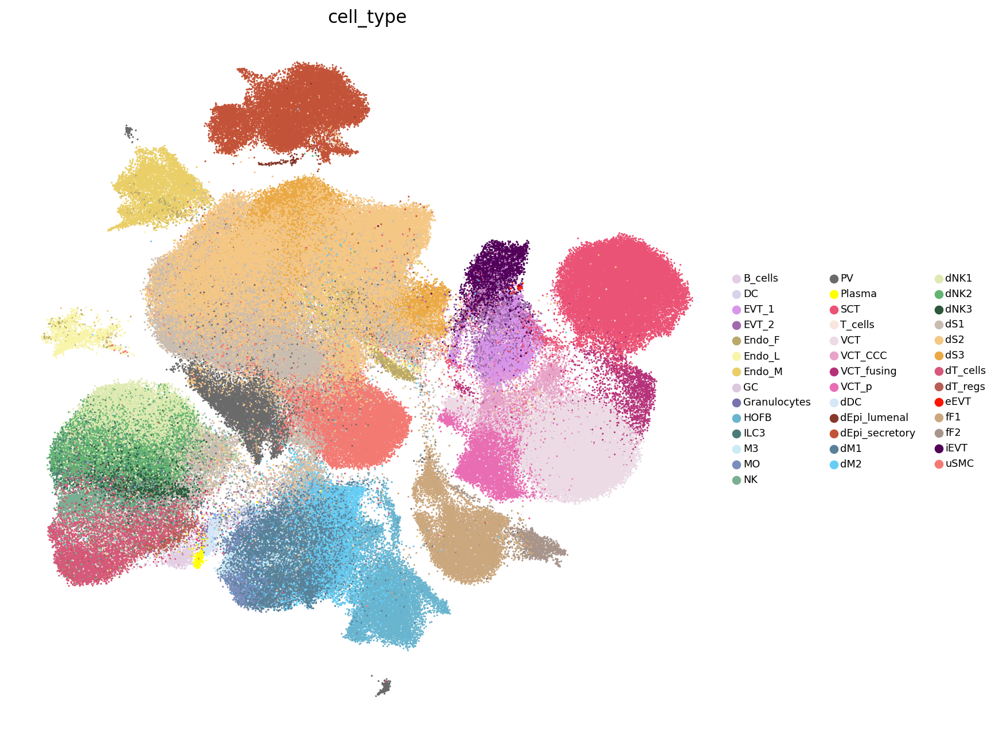

In [29]:
sc.set_figure_params(figsize=(10,10))
sc.pl.embedding(adata, curr_embedding_key,
                color=['cell_type'], palette=colors_final, frameon=False, 
                #legend_loc='on data', 
                legend_fontsize=8,
               size=8, save='_final_cell_types_all_donors.pdf')

In [19]:
adata.obs['dev_age']

barcode_sample
AAACGGGCATTGGCGC-1_FCA7167219           13_PCW
AAACGGGTCGCGATCG-1_FCA7167219           13_PCW
AAAGATGAGCAATATG-1_FCA7167219           13_PCW
AAAGATGAGTTCGCGC-1_FCA7167219           13_PCW
AAAGATGCATGTCGAT-1_FCA7167219           13_PCW
                                        ...   
TTTGTGTTCGTCAAGT-1_Pla_Camb10714920    8-9_PCW
TTTGTGTTCTTAGTCT-1_Pla_Camb10714920    8-9_PCW
TTTGTTGGTCACAGCG-1_Pla_Camb10714920    8-9_PCW
TTTGTTGGTTTACTTG-1_Pla_Camb10714920    8-9_PCW
TTTGTTGGTTTGAGCA-1_Pla_Camb10714920    8-9_PCW
Name: dev_age, Length: 350815, dtype: category
Categories (11, object): ['4_PCW', '5_PCW', '6_PCW', '7_PCW', ..., '11_PCW', '12-13_PCW', '12_PCW', '13_PCW']

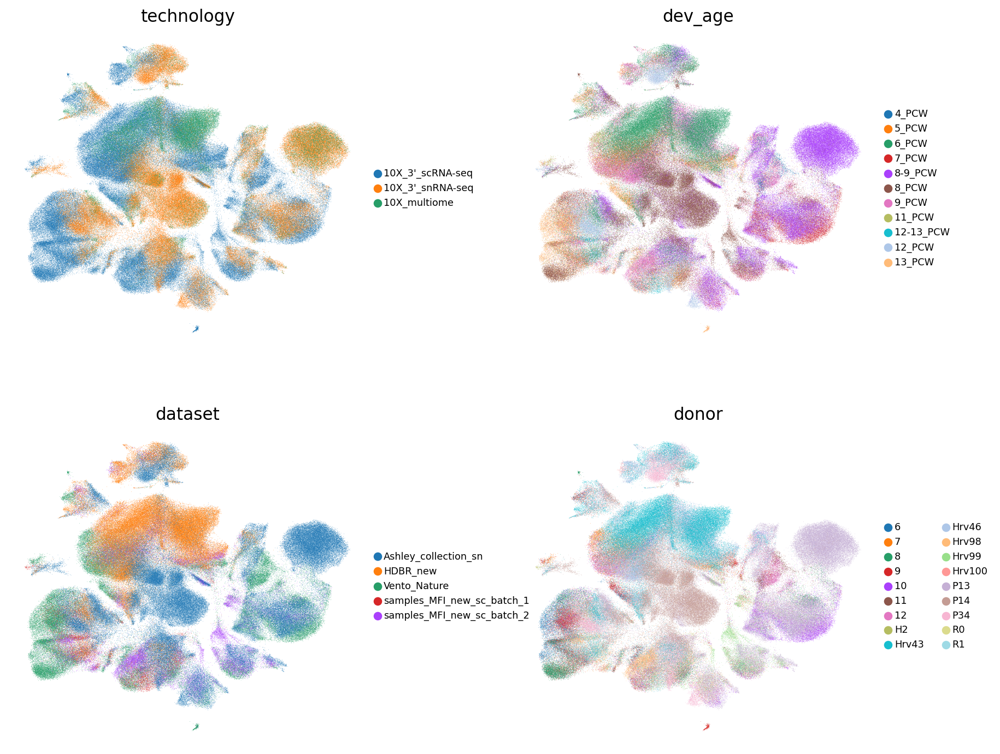

In [27]:
sc.set_figure_params(figsize=(5,5))
sc.pl.embedding(adata, curr_embedding_key,
                color=['technology','dev_age','dataset','donor'], frameon=False, 
                ncols=2,
                #legend_loc='on data', 
                legend_fontsize=8,
                wspace=0.3,
               #size=8
               )

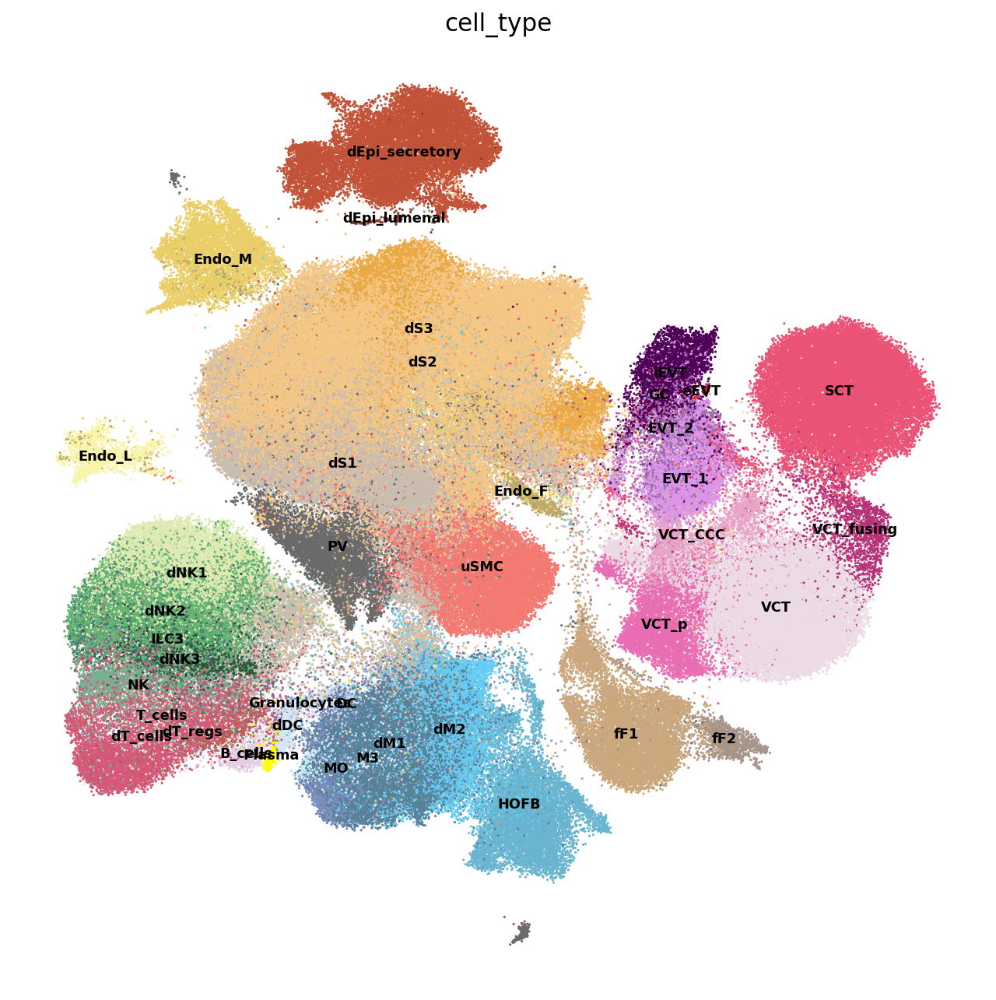

In [43]:
sc.set_figure_params(figsize=(10,10))
sc.pl.embedding(adata, curr_embedding_key,
                color=['cell_type'], palette=colors_final, frameon=False, 
                legend_loc='on data', 
                legend_fontsize=8,
               size=8, save='_final_cell_types_all_donors_legend_on_data.pdf')

In [9]:
# preparing object for cellxgene/reproductivecellatlas
adata

AnnData object with n_obs × n_vars = 350815 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01', 'coarse_annot', 'cell_type'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cell

In [10]:
adata.obsm['X_umap'] = adata.obsm['X_umap_scVI_n_latent_14_sample_n_layers_3']

In [11]:
# saving object for cellxgene
# in this object in .X are the normalised and log tr counts for all filtered cells and genes
adata

AnnData object with n_obs × n_vars = 350815 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01', 'coarse_annot', 'cell_type'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cell

In [12]:
save_path

'/lustre/scratch117/cellgen/team292/aa22/adata_objects/202111_MFI_sc_sn_new_scVI_analysis/'

In [13]:
import scipy
adata.X = scipy.sparse.csc_matrix(adata.X)


In [14]:
adata.obs.columns

Index(['n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor',
       'dataset', 'run', 'number_of_individuals_multiplexed', 'batch',
       'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score',
       'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities',
       'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet',
       'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05',
       'is_doublet_0.01', 'coarse_annot', 'cell_type'],
      dtype='object')

In [15]:
categ_columns = ['sample', 'technology', 'tissue', 'dev_age', 'donor',
       'dataset', 'run', 'number_of_individuals_multiplexed', 'batch',
       'percent_mito', 'n_counts', 
        'is_doublet', 'celltype_predictions',
       'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet',
       'phase', 'origin_M_F', 'is_doublet_0.05',
       'is_doublet_0.01', 'coarse_annot', 'cell_type']

cont_columns = ['n_genes', 'percent_mito',
       'n_counts', 'scrublet_score',
       'scrublet_cluster_score', 'bh_pval', 'probabilities', 'S_score', 'G2M_score']


In [16]:
for column in categ_columns:
    adata.obs[column] = pd.Categorical(adata.obs[column])
    
for column in cont_columns:
    adata.obs[column] = np.float32(adata.obs[column])

In [17]:
adata

AnnData object with n_obs × n_vars = 350815 × 30800
    obs: 'n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor', 'dataset', 'run', 'number_of_individuals_multiplexed', 'batch', 'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities', 'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet', 'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05', 'is_doublet_0.01', 'coarse_annot', 'cell_type'
    var: 'gene_ids-0', 'feature_types-0', 'genome-0', 'n_cells-0', 'gene_ids-1', 'feature_types-1', 'genome-1', 'n_cells-1', 'gene_ids-10', 'feature_types-10', 'genome-10', 'n_cells-10', 'gene_ids-11', 'feature_types-11', 'genome-11', 'n_cells-11', 'gene_ids-12', 'feature_types-12', 'genome-12', 'n_cells-12', 'gene_ids-13', 'feature_types-13', 'genome-13', 'n_cells-13', 'gene_ids-14', 'feature_types-14', 'genome-14', 'n_cells-14', 'gene_ids-15', 'feature_types-15', 'genome-15', 'n_cell

In [18]:
# removing a bunch of unnecessary metadata from .obs
adata.obs.columns

Index(['n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor',
       'dataset', 'run', 'number_of_individuals_multiplexed', 'batch',
       'percent_mito', 'n_counts', 'scrublet_score', 'scrublet_cluster_score',
       'bh_pval', 'is_doublet', 'celltype_predictions', 'probabilities',
       'barcode_sample_copy', 'souporcell_assignment', 'inter_ind_doublet',
       'S_score', 'G2M_score', 'phase', 'origin_M_F', 'is_doublet_0.05',
       'is_doublet_0.01', 'coarse_annot', 'cell_type'],
      dtype='object')

In [19]:
cols2keep = ['n_genes', 'sample', 'technology', 'tissue', 'dev_age', 'donor',
       'dataset','number_of_individuals_multiplexed', 'batch',
       'percent_mito', 'n_counts', 'celltype_predictions', 'probabilities',
       'S_score', 'G2M_score', 'phase', 'origin_M_F', 'coarse_annot', 'cell_type']
adata.obs = adata.obs.loc[:, cols2keep]

In [20]:
# to save for cellxgene/reproductivecellatlas
adata.write('/lustre/scratch117/cellgen/team292/aa22/sharing/202202_for_MFI_handover/objects_for_cellxgene_and_reproductivecellatlas/adata_all_donors_all_cell_states_normlog_counts_in_X_for_visualisation.h5ad')


In [21]:
# additionally, putting actual raw counts in .raw.X
adata_raw = sc.read(save_path + 'adata_raw_filtered.h5ad')
adata_raw = adata_raw[adata.obs_names,:]

# raw values
adata.raw = adata_raw.copy()

/opt/conda/lib/python3.8/site-packages/pandas/core/arrays/categorical.py:2487: FutureWarning: The `inplace` parameter in pandas.Categorical.remove_unused_categories is deprecated and will be removed in a future version.
  res = method(*args, **kwargs)


In [22]:
# additionally saving the same object for downloading after adding raw counts into the .raw.X layer
adata.write('/lustre/scratch117/cellgen/team292/aa22/sharing/202202_for_MFI_handover/objects_for_cellxgene_and_reproductivecellatlas/adata_all_donors_all_cell_states_raw_counts_in_raw_normlog_counts_in_X_for_download.h5ad')
